<a href="https://colab.research.google.com/github/AnkitNigam1985/Data-Science-Projects/blob/master/Term_5_Project_Ghoul_Prediction_Using_Classification_Models_updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Ghoul Prediction Using Classification Models**

## **1. Importing required libraries**

In [62]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn import preprocessing
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2


from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer

from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegressionCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier


from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

from sklearn import metrics

from sklearn.externals import joblib

In [ ]:
!pip install plotly

In [ ]:
import plotly
from plotly import tools
import plotly.express as px
import plotly.offline as pyo
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objects as go
pyo.init_notebook_mode()

In [ ]:
!pip install pyod

In [ ]:
from pyod.models.abod import ABOD
from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning:

The sklearn.utils.testing module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.utils. Anything that cannot be imported from sklearn.utils is now part of the private API.



In [ ]:
!pip install autoviz

In [ ]:
!pip install xgboost

In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class

AV=AutoViz_Class()

Imported AutoViz_Class version: 0.0.68. Call using: 
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
            
To remove previous versions, perform 'pip uninstall autoviz'


In [ ]:
!pip install pycaret

In [ ]:
from pycaret.classification import *

In [ ]:
!pip install pandas-profiling==2.5.0

In [ ]:
from pandas_profiling import ProfileReport

## **2. Reading Train and Test data**

In [3]:
ghoul_train=pd.read_csv("https://raw.githubusercontent.com/insaid2018/Term-4/master/Projects/Ghouls_train.csv")
ghoul_train.head()

,id,bone_length,rotting_flesh,hair_length,has_soul,color,type
0,0,0.354512,0.350839,0.465761,0.781142,clear,Ghoul
1,1,0.575560,0.425868,0.531401,0.439899,green,Goblin
2,2,0.467875,0.354330,0.811616,0.791225,black,Ghoul
3,4,0.776652,0.508723,0.636766,0.884464,black,Ghoul
4,5,0.566117,0.875862,0.418594,0.636438,green,Ghost


In [4]:
ghoul_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 371 entries, 0 to 370
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             371 non-null    int64  
 1   bone_length    371 non-null    float64
 2   rotting_flesh  371 non-null    float64
 3   hair_length    371 non-null    float64
 4   has_soul       371 non-null    float64
 5   color          371 non-null    object 
 6   type           371 non-null    object 
dtypes: float64(4), int64(1), object(2)
memory usage: 20.4+ KB


In [5]:
ghoul_test=pd.read_csv("https://raw.githubusercontent.com/insaid2018/Term-4/master/Projects/Ghouls_test.csv")
ghoul_test.head()

,id,bone_length,rotting_flesh,hair_length,has_soul,color
0,3,0.471774,0.387937,0.706087,0.698537,black
1,6,0.427332,0.645024,0.565558,0.451462,white
2,9,0.549602,0.491931,0.660387,0.449809,black
3,10,0.638095,0.682867,0.471409,0.356924,white
4,13,0.361762,0.583997,0.377256,0.276364,black


In [6]:
ghoul_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529 entries, 0 to 528
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             529 non-null    int64  
 1   bone_length    529 non-null    float64
 2   rotting_flesh  529 non-null    float64
 3   hair_length    529 non-null    float64
 4   has_soul       529 non-null    float64
 5   color          529 non-null    object 
dtypes: float64(4), int64(1), object(1)
memory usage: 24.9+ KB


In both train and test dataset, we have following input features

- id
- bone_length
- rotting_flesh
- hair_length
- has_soul
- color

and output target in train data

 - type
 
 
Where all columns are float/int but color and type are of obejct type, which need to be encoded later using Label Encoder

## **3. Statistical Analysis of Train and Test data**

id field can be removed during data preprocessing and modelling

In [7]:
ghoul_train_org=ghoul_train.copy()
ghoul_train=ghoul_train.drop('id', axis=1)

In [8]:
ghoul_test_org=ghoul_test.copy()
ghoul_test=ghoul_test.drop('id', axis=1)

In [ ]:
ghoul_train.head()

,bone_length,rotting_flesh,hair_length,has_soul,color,type
0,0.354512,0.350839,0.465761,0.781142,clear,Ghoul
1,0.575560,0.425868,0.531401,0.439899,green,Goblin
2,0.467875,0.354330,0.811616,0.791225,black,Ghoul
3,0.776652,0.508723,0.636766,0.884464,black,Ghoul
4,0.566117,0.875862,0.418594,0.636438,green,Ghost


In [ ]:
ghoul_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 371 entries, 0 to 370
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bone_length    371 non-null    float64
 1   rotting_flesh  371 non-null    float64
 2   hair_length    371 non-null    float64
 3   has_soul       371 non-null    float64
 4   color          371 non-null    object 
 5   type           371 non-null    object 
dtypes: float64(4), object(2)
memory usage: 17.5+ KB


In [ ]:
ghoul_train.isnull().sum()

bone_length      0
rotting_flesh    0
hair_length      0
has_soul         0
color            0
type             0
dtype: int64

In [ ]:
ghoul_test.head()

,bone_length,rotting_flesh,hair_length,has_soul,color
0,0.471774,0.387937,0.706087,0.698537,black
1,0.427332,0.645024,0.565558,0.451462,white
2,0.549602,0.491931,0.660387,0.449809,black
3,0.638095,0.682867,0.471409,0.356924,white
4,0.361762,0.583997,0.377256,0.276364,black


In [ ]:
ghoul_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529 entries, 0 to 528
Data columns (total 5 columns):
bone_length      529 non-null float64
rotting_flesh    529 non-null float64
hair_length      529 non-null float64
has_soul         529 non-null float64
color            529 non-null object
dtypes: float64(4), object(1)
memory usage: 20.8+ KB


In [ ]:
ghoul_test.isnull().sum()

bone_length      0
rotting_flesh    0
hair_length      0
has_soul         0
color            0
dtype: int64

No missing data in train and test datasets

In [ ]:
ghoul_train.describe().T

,count,mean,std,min,25%,50%,75%,max
bone_length,371.0,0.434160,0.132833,0.061032,0.340006,0.434891,0.517223,0.817001
rotting_flesh,371.0,0.506848,0.146358,0.095687,0.414812,0.501552,0.603977,0.932466
hair_length,371.0,0.529114,0.169902,0.134600,0.407428,0.538642,0.647244,1.000000
has_soul,371.0,0.471392,0.176129,0.009402,0.348002,0.466372,0.600610,0.935721


In [ ]:
#Verifying if max values for each column in should not be too large in comparison of mean + 3 std (almost)

print ((ghoul_train.describe().T.loc['bone_length','std'] + 3 * ghoul_train.describe().T.loc['bone_length','mean'])<ghoul_train.describe().T.loc['bone_length','max'])
print ((ghoul_train.describe().T.loc['rotting_flesh','std'] + 3 * ghoul_train.describe().T.loc['rotting_flesh','mean'])<ghoul_train.describe().T.loc['rotting_flesh','max'])
print ((ghoul_train.describe().T.loc['hair_length','std'] + 3 * ghoul_train.describe().T.loc['hair_length','mean'])<ghoul_train.describe().T.loc['hair_length','max'])
print ((ghoul_train.describe().T.loc['has_soul','std'] + 3 * ghoul_train.describe().T.loc['has_soul','mean'])<ghoul_train.describe().T.loc['has_soul','max'])

False
False
False
False


In [ ]:
ghoul_train.color.value_counts()

white    137
clear    120
green     42
black     41
blue      19
blood     12
Name: color, dtype: int64

In [ ]:
ghoul_train.type.value_counts()

Ghoul     129
Goblin    125
Ghost     117
Name: type, dtype: int64

- Total 371 records in train data
- All the fields have mean value almost similar to corresponding median(50%) value, so data distribution seems to be nearly normal.
- Also, no outlier seems to be present as per above initial analysis, all max values seems to be in range of 3 std from mean.
- color field has values in 6 categories
- And, target variable has 3 output classes

In [ ]:
ghoul_test.describe()

,bone_length,rotting_flesh,hair_length,has_soul
count,529.000000,529.000000,529.000000,529.000000
mean,0.425474,0.503637,0.517288,0.464096
std,0.136079,0.158552,0.171727,0.179659
min,0.000000,0.000000,0.000000,0.000000
25%,0.329383,0.393987,0.388189,0.338964
50%,0.421989,0.510065,0.520220,0.461294
75%,0.519024,0.605957,0.644824,0.584448
max,1.000000,1.000000,0.999841,1.000000


In [ ]:
#Verifying if max values for each column in should not be too large in comparison of mean + 3 std (almost)

print ((ghoul_test.describe().T.loc['bone_length','std'] + 3 * ghoul_test.describe().T.loc['bone_length','mean'])<ghoul_test.describe().T.loc['bone_length','max'])
print ((ghoul_test.describe().T.loc['rotting_flesh','std'] + 3 * ghoul_test.describe().T.loc['rotting_flesh','mean'])<ghoul_test.describe().T.loc['rotting_flesh','max'])
print ((ghoul_test.describe().T.loc['hair_length','std'] + 3 * ghoul_test.describe().T.loc['hair_length','mean'])<ghoul_test.describe().T.loc['hair_length','max'])
print ((ghoul_test.describe().T.loc['has_soul','std'] + 3 * ghoul_test.describe().T.loc['has_soul','mean'])<ghoul_test.describe().T.loc['has_soul','max'])

False
False
False
False


In [ ]:
ghoul_test.color.value_counts()

white    197
clear    172
black     63
green     53
blue      35
blood      9
Name: color, dtype: int64

- Total 529 records in test data
- All the fields have mean value almost similar to corresponding median(50%) value, so data distribution seems to be nearly normal.
- Also, no outlier seems to be present as per above initial analysis, all max values seems to be in range of 3 std from mean.
- color field has values in 6 categories
- And, target variable has 3 output classes

From the statistical analysis, it seems no outliers present but need to be analyzed further with other methods  - visualization, pyOD and PyCaret

## **4. Exploratory Data Analysis with Pandas Profiling and AutoViz**

### **4.1. Analysis using Pandas Profiling**

In [ ]:
prof_train=ProfileReport(ghoul_train)
prof_train.to_file(output_file='Ghoul_train_profiling.html')

- All the columns have almost normal distribution as already checked from describe() output.
- Kurtosis and skeeness are between -0.5 to 0.5 , so almost near to 0 which seems to be normally distributed data.
- Some positive correlation seems to be between bone_length and hair_length.
- Some positive correlation seems to be between bone_length and has_soul.
- Some positive correlation seems to be between hair_length and has_soul.
- Some negative correlation seems to be between rotting_flesh and hair_length
- rotting_flesh is not seems to be related to any field.

In [ ]:
prof_test=ProfileReport(ghoul_test)
prof_test.to_file(output_file='Ghoul_test_profiling.html')

- All the columns have almost normal distribution as already checked from describe() output.
- Kurtosis and skeeness are between -0.5 to 0.5 , so almost near to 0 which seems to be normally distributed data.
- Some positive correlation seems to be between bone_length and hair_length.
- Some positive correlation seems to be between bone_length and has_soul.
- Some positive correlation seems to be between hair_length and has_soul.
- rotting_flesh is not seems to be related to any field.

### **4.2. Analysis using AutoViz**

Shape of your Data Set: (371, 7)
Classifying variables in data set...
    7 Predictors classified...
        This does not include the Target column(s)
    1 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 10
Time to run AutoViz (in seconds) = 2.174


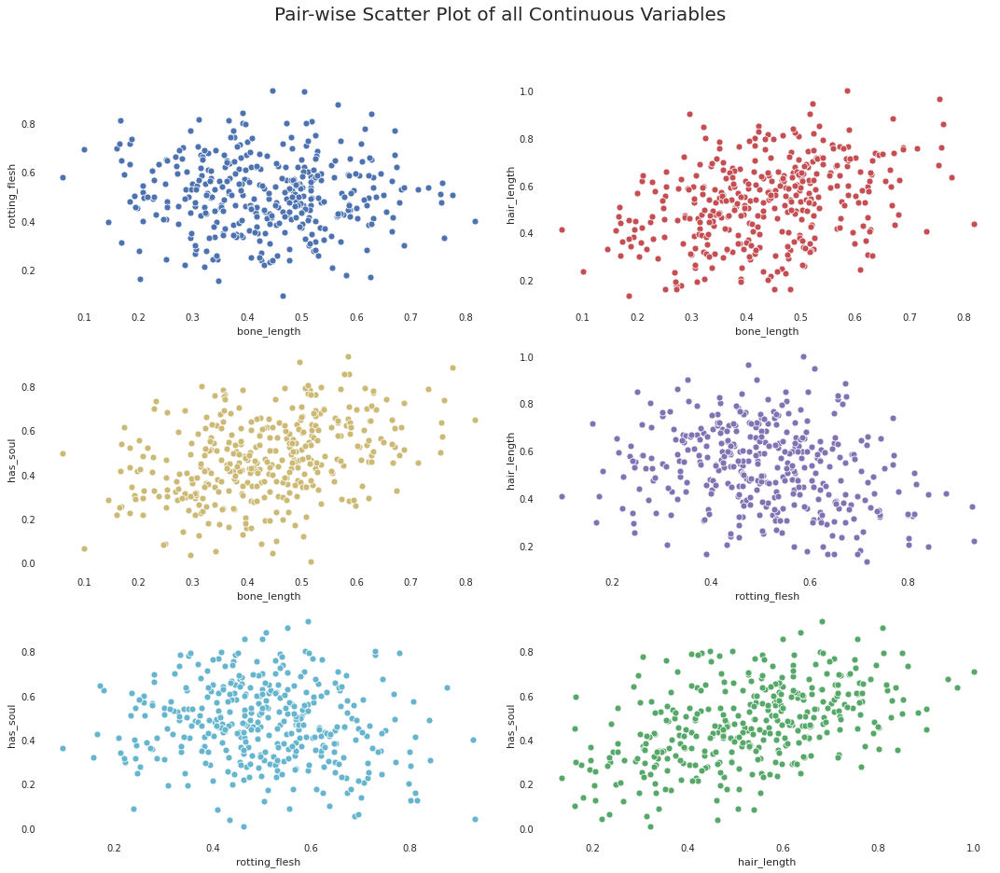

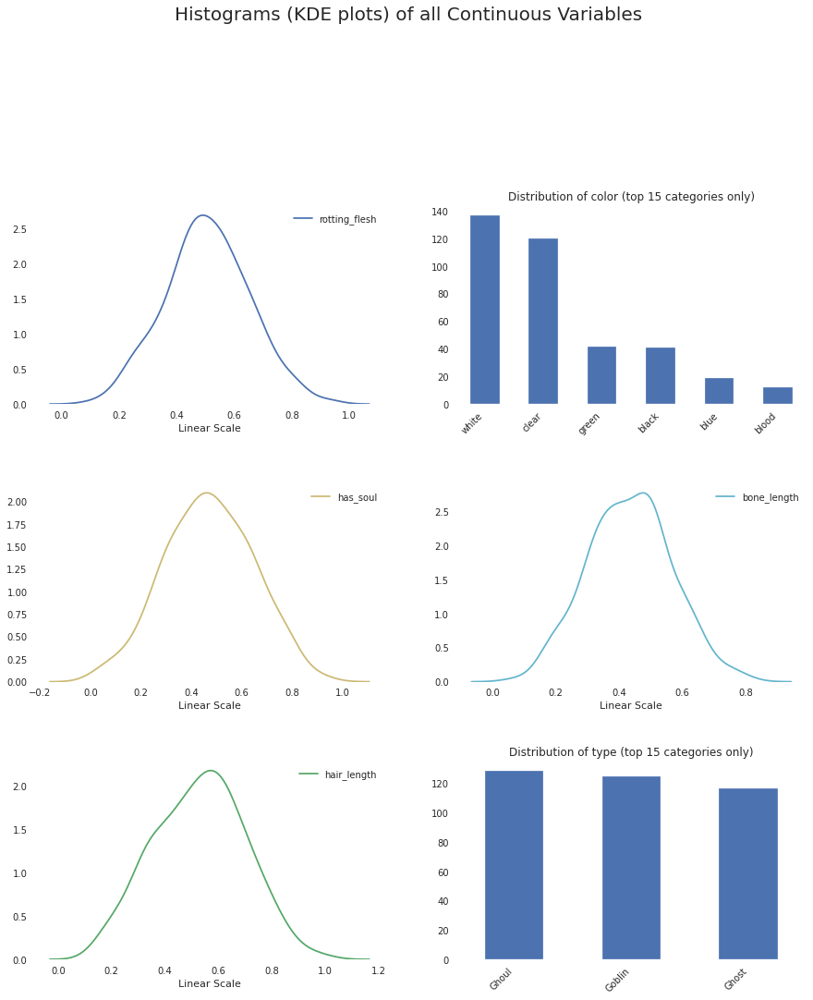

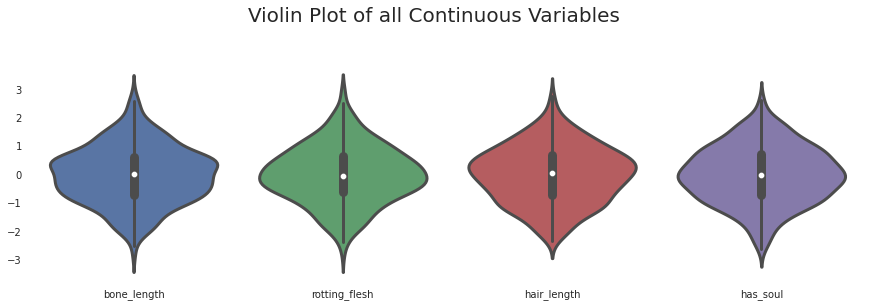

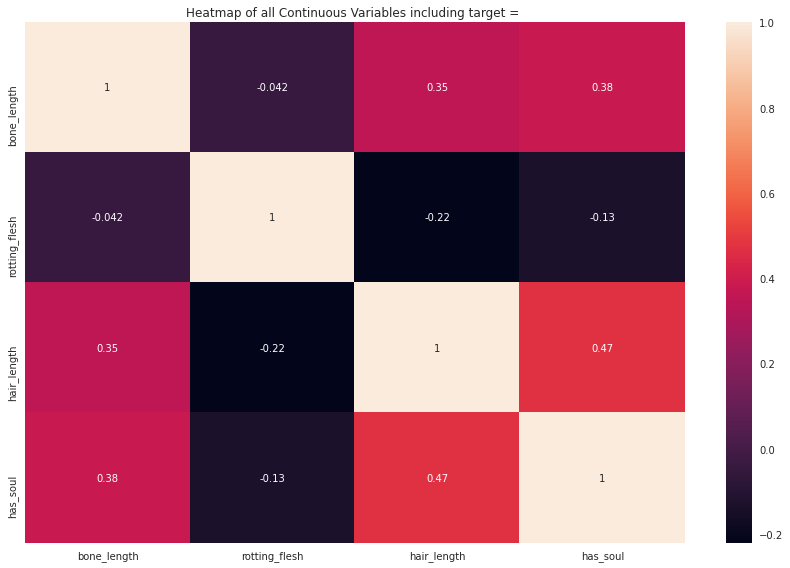

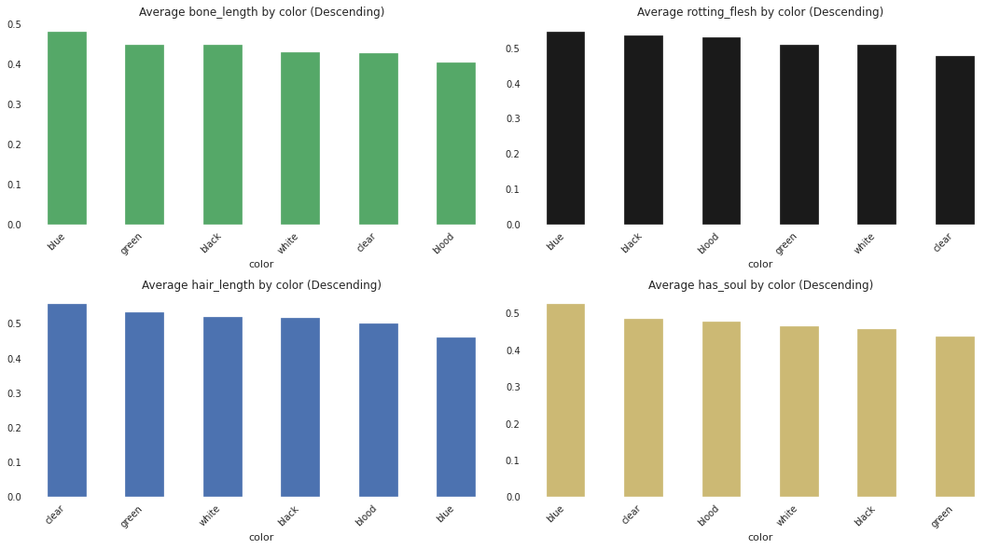

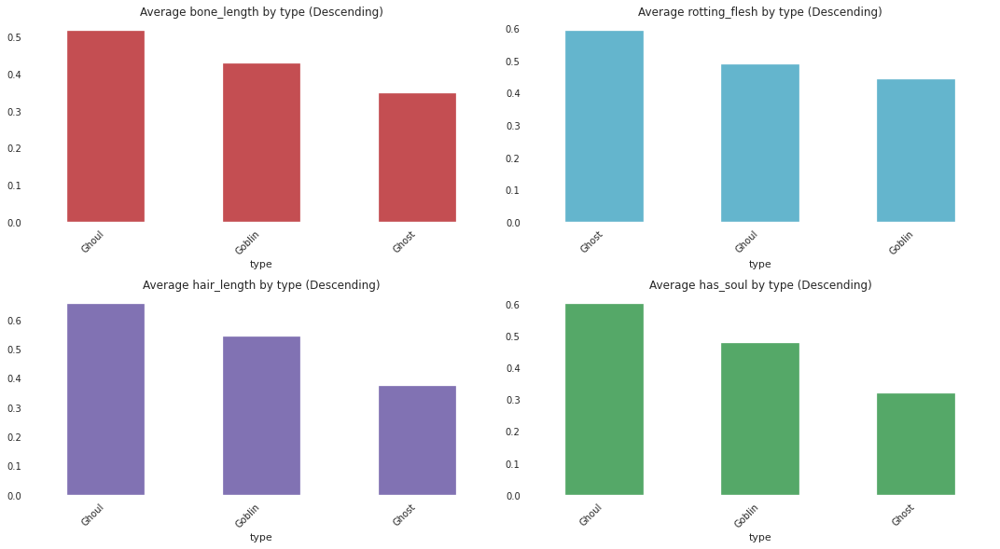

In [ ]:
aftrain=AV.AutoViz('https://raw.githubusercontent.com/insaid2018/Term-4/master/Projects/Ghouls_train.csv')

From the above graphs related to correlation(scatter and heatmap) and distribution plots(histogram,KDE and bar chart for categorical columns), observed that-

- Distribution is normal for all the columns with continuos values
- No data imbalance issue wrt target variable
- Positive correlation between hair_length/bone_length, has_soul/bone_length, has_soul/hair_length  while rotting_flesh has no high correlation with any other columns.
- Also based on color value distribution, it has similar values, for different values of bone_lenght,hair_lenght,rotting_flesh and has_soul.
- Ghoul type in target column seems to have majority when high average  value of bone_length,hair_length and has_soul.
- But, Ghost type in target column seems to have majority for higher values of rotting_flesh.

- So, for Ghoul - higher average values of bone_length,hair_length and has_soul are good reference point, while for Ghost has lowest average value of these colummsn from all the categories in type column.

- For Ghost - high average value of rotting_flesh and low average values for bone_length,hair_length and has_soul

- Gobline value in type  has values in middle range for all the input features.

Shape of your Data Set: (529, 6)
Classifying variables in data set...
    6 Predictors classified...
        This does not include the Target column(s)
    1 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 10
Time to run AutoViz (in seconds) = 1.952


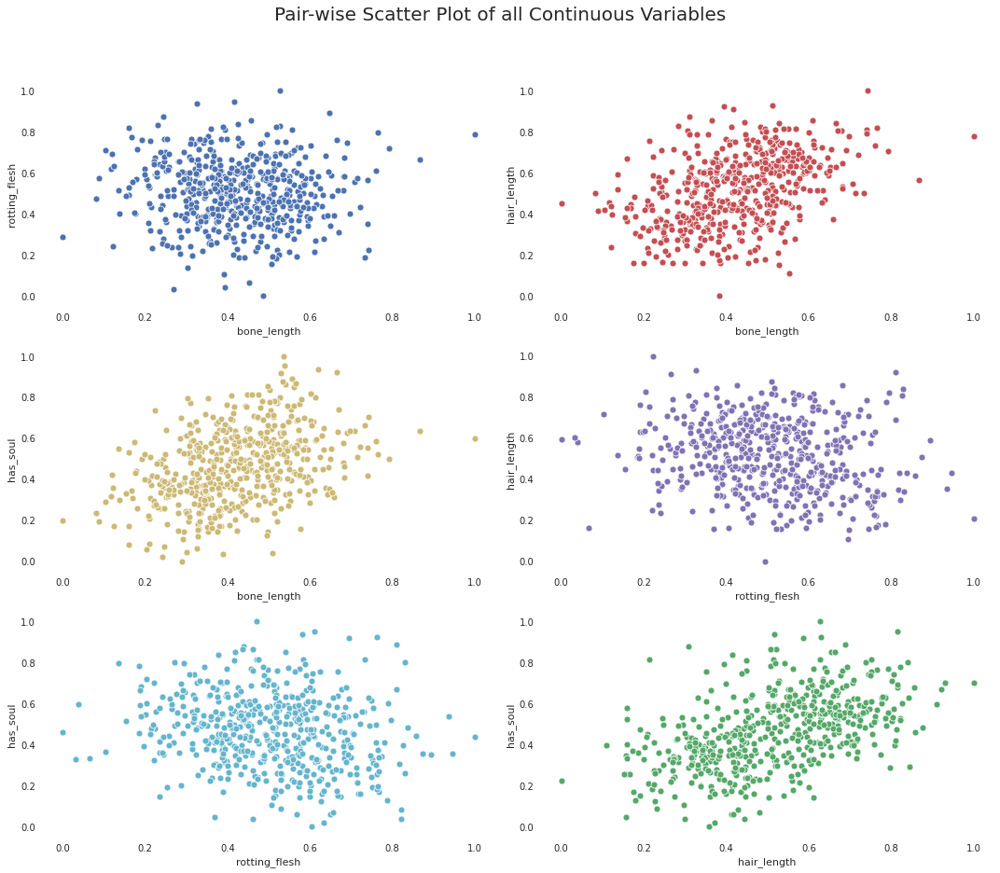

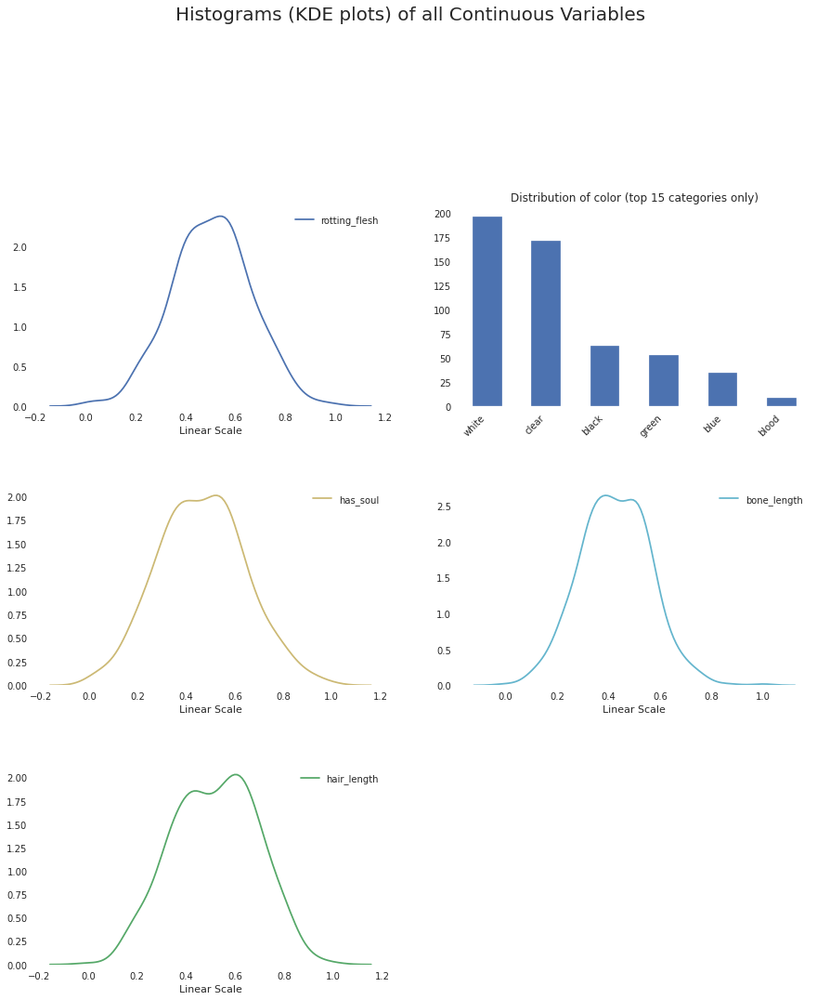

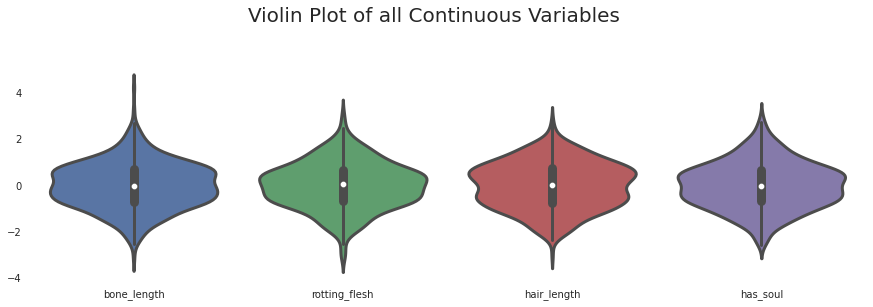

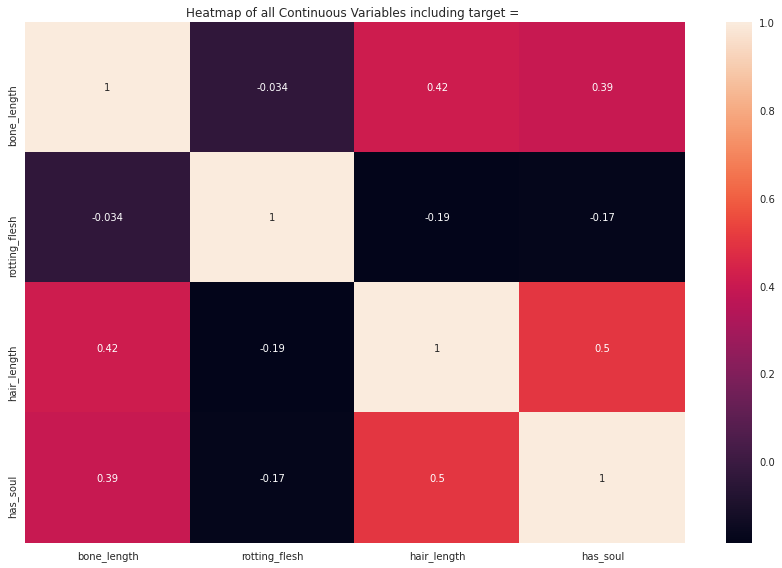

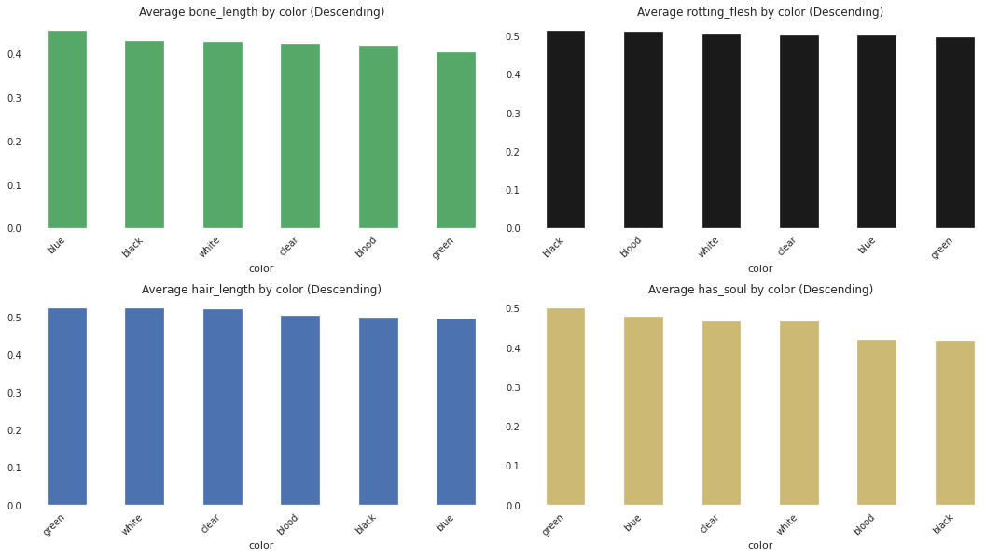

In [ ]:
aftest=AV.AutoViz('https://raw.githubusercontent.com/insaid2018/Term-4/master/Projects/Ghouls_test.csv')

From the above graphs related to correlation(scatter and heatmap) and distribution plots(histogram,KDE and bar chart for categorical columns), observed that-

- Distribution is normal for all the columns with continuos values
- No data imbalance issue wrt target variable
- Positive correlation between hair_length/bone_length, has_soul/bone_length, has_soul/hair_length  while rotting_flesh has no high correlation with any other columns.
- Also based on color value distribution, it has similar values, for different values of bone_lenght,hair_lenght,rotting_flesh and has_soul.

So, from the above analysis of Train and Test data, the data points seems similar in both the datasets.

## **5. Exploratory Data Analysis**

Though, we have done the analysis using Pandas Profiling and AutoViz, but further analysis to get more information

### **5.1. Checking Distribution of Train Dataset**

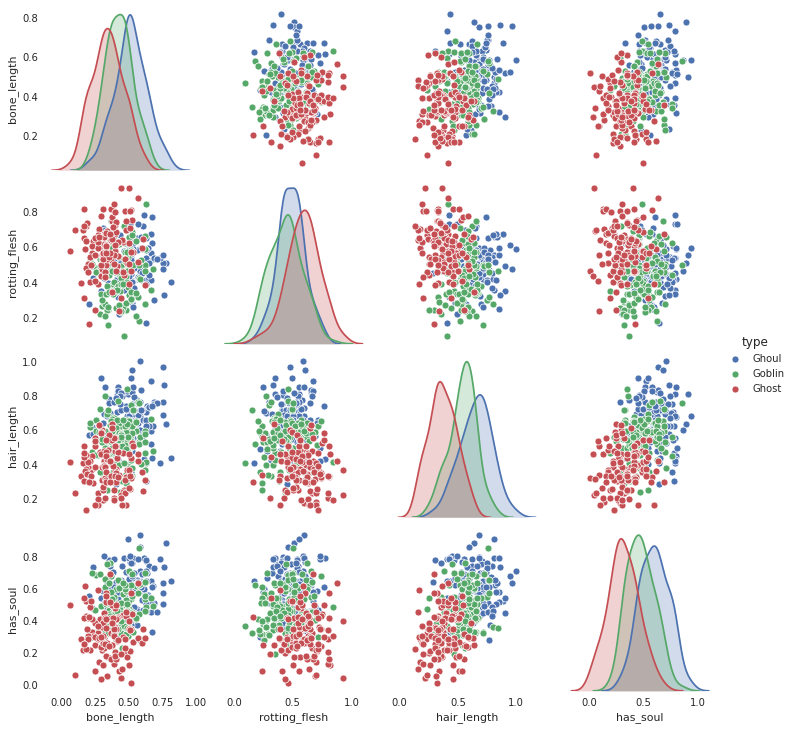

In [ ]:
sns.pairplot(ghoul_train,hue='type')
plt.show()

- Normally distributed for all the types in target column
- For Ghoul, values ranges from 0.6-0.8 in all distributions, but Goblin and Ghost have more range of values - 0-0.6.
- All the input features have high values for Ghoul type except rotting_flesh which has higher values for Ghost type.

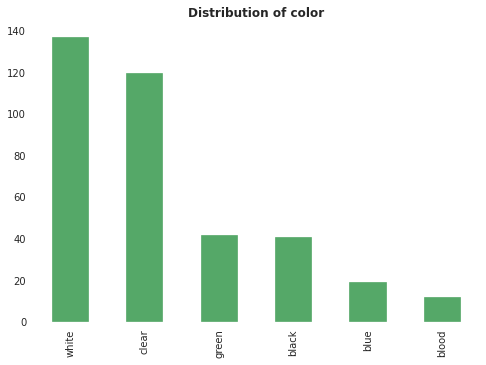

In [ ]:
ghoul_train.color.value_counts().plot(kind='bar', color='g')
plt.title("Distribution of color", fontdict={'fontweight':'bold'})
plt.show()

White and Clear has mjaor distribution of data in dataset when compared to other values

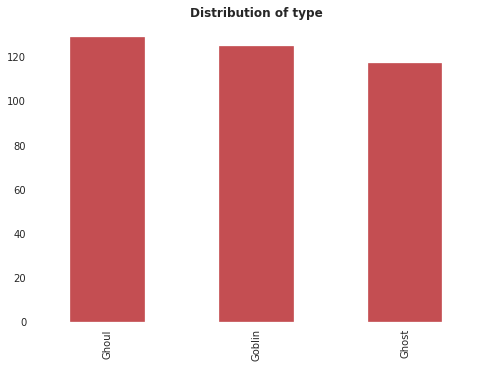

In [ ]:
ghoul_train.type.value_counts().plot(kind='bar', color='r')
plt.title("Distribution of type", fontdict={'fontweight':'bold'})
plt.show()

All the types have similar range, so no data imbalance

### **5.2. Checking Distribution of Test Dataset**

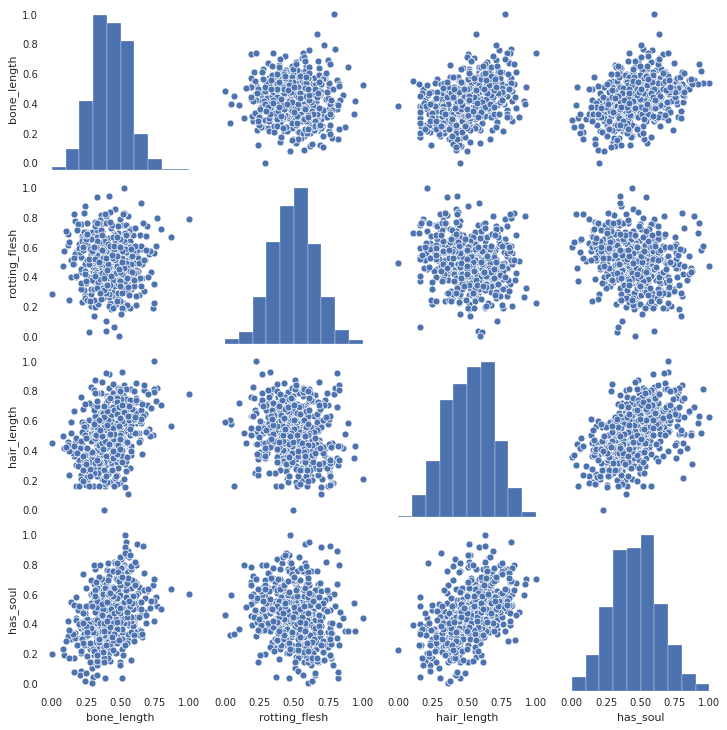

In [ ]:
sns.pairplot(ghoul_test,palette='Accent1')
plt.show()

- Normally distributed for all the types in target column
- All the columns have postive correlation among each other except rotting_flesh

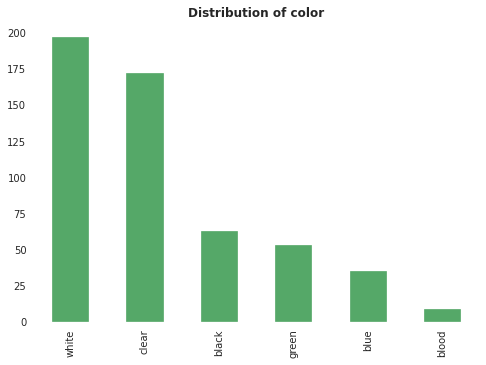

In [ ]:
ghoul_test.color.value_counts().plot(kind='bar', color='g')
plt.title("Distribution of color", fontdict={'fontweight':'bold'})
plt.show()

Similar to Train data, White and Clear has mjaor distribution of data in dataset when compared to other values

### **5.3. Checking Relationship in Train Dataset**

In [ ]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [ ]:
from plotly.offline import iplot
import plotly.graph_objs as go

In [ ]:
enable_plotly_in_cell()
fig = go.Figure(data=go.Heatmap(z=ghoul_train.corr(),  x=['bone_length','rotting_flesh','hair_length','has_soul'], 
                y=['bone_length','rotting_flesh','hair_length','has_soul']))

fig.show()
configure_plotly_browser_state()

 - No column is highly correlated to each other.
 - Though some positive correlation between hair_length/bone_length(0.35), hair_length/has_soul(0.47), bone_length/has_soul(0.38), but none of them are highly correlated.

In [ ]:
def plot_scattermatrix(df, title):

    x=['bone_length','rotting_flesh','hair_length','has_soul']
    y=['bone_length','rotting_flesh','hair_length','has_soul']

    data=[]
    nm=""
    i=0
    j=0
    fig=plotly.subplots.make_subplots(rows=4, cols=4)
    for col1 in x:
        i=i+1
        j=0
        for col2 in y:
            j=j+1
            nm=str(col1)+" vs "+str(col2)
            trace=go.Scatter(
                x=df[col1], 
                y=df[col2],
                mode='markers', name=nm)

            fig.append_trace(trace, i, j)


    fig.layout.update(height=1000, width=1000, title=title)
    iplot(fig)

In [ ]:
enable_plotly_in_cell()
plot_scattermatrix(ghoul_train, "Correlation Matrix for Train data")

Most of the data points lies between 0.3 to 0.6 range and further zooming-in on the plots, can observe some outliers (though not by huge margin)

- rotting_flesh  - some data points in range of 0.92 and 0.93 and one data point as low as below 0.1
- bone_length - one data point has value of 0.81
- hair_length  - one data point has value of 1

### **5.4. Checking Relationship in Test Dataset**

In [ ]:
enable_plotly_in_cell()
fig = go.Figure(data=go.Heatmap(z=ghoul_test.corr(),  x=['bone_length','rotting_flesh','hair_length','has_soul'], 
                y=['bone_length','rotting_flesh','hair_length','has_soul']))

fig.show()

has_soul/hair_length has positive correlation of 0.50, while, hair_length/bone_lenght, bone_length/has_soul has positive correlation of 0.40 approx.

Similar to Train dataset, columns have positive correlation, but correlation coefficient is not too much high.

In [ ]:
enable_plotly_in_cell()
plot_scattermatrix(ghoul_test, "Correlation Matrix for Test data")

The relation between columns are positive correlation as observed in previous graph.

But, could observe few outliers - 

- bone_length - data points in range too high as 1 and too low as 0.
- rotting_flesh - data point with value 1
- hair_length - data points at value of 0.99 and 0
- has_soul  - data point with value 1

From the above observation, found out that-

- correlation between columns but not too high in both the data sets.
- Few outliers but more outliers observed in test dataset, more can be analyzed further using box plot on test and train datasets.
- From the scatter plot, seems like data points are not linearly seperable.

### **5.5. Checking Outliers in Train Dataset**

In [ ]:
def plot_outliers(df):
    cols=['bone_length','rotting_flesh','hair_length','has_soul']
    trace=[]
    for col in cols:
        trace.append(go.Box(y=df[col],name=col))
    data=trace
    iplot({"data":data})

In [ ]:
enable_plotly_in_cell()
plot_outliers(ghoul_train)

As observed before we have few outliers for bone_length and rotting_flesh output above.

Further more analysis done below to get the details based on interquartile range based calcualtion to get extreme limits to detect outliers beyond those limits.

Also, the median value of hair_length and rotting_flesh is higher as compared to other features with hair_length has relative higher extreme value.

bone_length has lowest median value of all, but has_soul has minimum value at 0 and highest value more than of rotting_flesh even when its median value is low that rotting_flesh.

In [ ]:
def get_outlier_info(df):
    Q1=df.quantile(0.25)
    Q3=df.quantile(0.75)
    IQR=Q3-Q1
    #print (IQR)
    return df[((df<(Q1-IQR*1.5)) | (df>(Q3+IQR*1.5))).any(axis=1)]

In [ ]:
ghoul_train_out=get_outlier_info(ghoul_train)
print (ghoul_train_out.shape)
ghoul_train_out

(5, 6)


,bone_length,rotting_flesh,hair_length,has_soul,color,type
52,0.445132,0.932466,0.218732,0.043321,clear,Ghost
166,0.817001,0.400808,0.437047,0.648230,green,Ghoul
174,0.061032,0.578567,0.415440,0.497098,black,Ghost
194,0.465423,0.095687,0.406791,0.364341,black,Goblin
266,0.503780,0.929440,0.366461,0.401567,blue,Ghost


In [ ]:
train_out_indexes=ghoul_train_out.index.to_list()
train_out_indexes

[52, 166, 174, 194, 266]

In [ ]:
def get_outlier_colinfo(df, col):
    Q1=df[col].quantile(0.25)
    Q3=df[col].quantile(0.75)
    IQR=Q3-Q1
    #print (IQR)
    print (df[((df[col]<(Q1-IQR*1.5)) | (df[col]>(Q3+IQR*1.5)))])

In [ ]:
get_outlier_colinfo(ghoul_train, 'bone_length')

     bone_length  rotting_flesh  hair_length  has_soul  color   type
166     0.817001       0.400808     0.437047  0.648230  green  Ghoul
174     0.061032       0.578567     0.415440  0.497098  black  Ghost


In [ ]:
get_outlier_colinfo(ghoul_train, 'rotting_flesh')

     bone_length  rotting_flesh  hair_length  has_soul  color    type
52      0.445132       0.932466     0.218732  0.043321  clear   Ghost
194     0.465423       0.095687     0.406791  0.364341  black  Goblin
266     0.503780       0.929440     0.366461  0.401567   blue   Ghost


In [ ]:
get_outlier_colinfo(ghoul_train, 'hair_length')

Empty DataFrame
Columns: [bone_length, rotting_flesh, hair_length, has_soul, color, type]
Index: []


In [ ]:
get_outlier_colinfo(ghoul_train, 'has_soul')

Empty DataFrame
Columns: [bone_length, rotting_flesh, hair_length, has_soul, color, type]
Index: []


2 outliers in bone_length and 3 outliers in rotting_flesh which can be removed from dataset for further analysis.

### **5.6. Checking Outliers in Test Dataset**

In [ ]:
enable_plotly_in_cell()
plot_outliers(ghoul_test)

There seems to be higher number of outliers in test dataset.

- 3 in bone_length - 0, 0.86, 1
- 7 in rotting_flesh - 0,0.03,0.06 and 0.9 onwards
- 1 each in hair_length(0) and has_soul(1)

In [ ]:
ghoul_test_out=get_outlier_info(ghoul_test)
print (ghoul_test_out.shape)
ghoul_test_out

(12, 5)


,bone_length,rotting_flesh,hair_length,has_soul,color
25,0.394139,0.039409,0.579969,0.594723,clear
54,0.268448,0.031918,0.605018,0.325475,white
81,0.486938,0.000000,0.592129,0.459778,white
86,0.000000,0.288135,0.450938,0.200262,white
104,1.000000,0.788660,0.777894,0.599683,white
140,0.535189,0.471686,0.627319,1.000000,blue
148,0.382209,0.493693,0.000000,0.224168,white
265,0.867414,0.666680,0.566671,0.635640,white
314,0.526535,1.000000,0.207614,0.438302,white
320,0.326442,0.936041,0.352307,0.538078,clear


In [ ]:
test_out_indexes=ghoul_test_out.index.to_list()
test_out_indexes

[25, 54, 81, 86, 104, 140, 148, 265, 314, 320, 439, 505]

In [ ]:
get_outlier_colinfo(ghoul_test, 'bone_length')

     bone_length  rotting_flesh  hair_length  has_soul  color
86      0.000000       0.288135     0.450938  0.200262  white
104     1.000000       0.788660     0.777894  0.599683  white
265     0.867414       0.666680     0.566671  0.635640  white


In [ ]:
get_outlier_colinfo(ghoul_test, 'rotting_flesh')

     bone_length  rotting_flesh  hair_length  has_soul  color
25      0.394139       0.039409     0.579969  0.594723  clear
54      0.268448       0.031918     0.605018  0.325475  white
81      0.486938       0.000000     0.592129  0.459778  white
314     0.526535       1.000000     0.207614  0.438302  white
320     0.326442       0.936041     0.352307  0.538078  clear
439     0.415794       0.946247     0.428107  0.354386  white
505     0.452508       0.065838     0.159416  0.333775  clear


In [ ]:
get_outlier_colinfo(ghoul_test, 'hair_length')

     bone_length  rotting_flesh  hair_length  has_soul  color
148     0.382209       0.493693          0.0  0.224168  white


In [ ]:
get_outlier_colinfo(ghoul_test, 'has_soul')

     bone_length  rotting_flesh  hair_length  has_soul color
140     0.535189       0.471686     0.627319       1.0  blue


From the above, analyzed test data have certainly high number of outliers(as dataset have high number of records as compared to train dataset), but the outliers are not seperated by high margin.

Outliers are further analyzed using other techniques as well to get some insight .

Also, further, models can be implemented on both the ways - dataset with outliers and dataset without outliers

### **5.7. Checking Outliers in Test and Train Dataset using Isolation Forest**

In [ ]:
#ghoul_train_bone_length=ghoul_train['bone_length'].copy()
#ghoul_train_hair_length=ghoul_train['hair_length'].copy()
#ghoul_train_has_soul=ghoul_train['has_soul'].copy()
#ghoul_train_rotting_flesh=ghoul_train['rotting_flesh'].copy()

In [ ]:
from sklearn.ensemble import IsolationForest

def get_outlier_isolation_forest(df, col, num_estimator):
    isolation_forest = IsolationForest(n_estimators=num_estimator)
    #isolation_forest.fit(df[col].values.reshape(-1, 1))
    isolation_forest.fit(df[[col]])
    #xx = np.linspace(df[col].min(), df[col].max(), len(df)).reshape(-1,1)
    df['anomaly_score'] = isolation_forest.decision_function(df[[col]])
    df['outlier'] = isolation_forest.predict(df[[col]])
    #plt.figure(figsize=(10,4))
    #plt.plot(df[col], anomaly_score, label='anomaly score')
    #plt.fill_between(df[col].T[0], np.min(anomaly_score), np.max(anomaly_score), 
     #                where=outlier==-1, color='r', 
      #               alpha=.4, label='outlier region')
    #plt.legend()
    #plt.ylabel('anomaly score')
    #plt.xlabel(col)
    #plt.show()
    return df

**Train Data**

In [ ]:
ghoul_train_bone_length=pd.DataFrame(ghoul_train['bone_length'].copy())
ghoul_train_bone_length=get_outlier_isolation_forest(ghoul_train_bone_length, 'bone_length', 100)
ghoul_train_bone_length[ghoul_train_bone_length.outlier==-1]

,bone_length,anomaly_score,outlier
3,0.776652,-0.212094,-1
9,0.280942,-0.005592,-1
16,0.250770,-0.016097,-1
18,0.605836,-0.018203,-1
24,0.687256,-0.085689,-1
...,...,...,...
344,0.165196,-0.105567,-1
345,0.712913,-0.149862,-1
350,0.203073,-0.052118,-1
351,0.552971,-0.009718,-1


In [ ]:
ghoul_train_bone_length[ghoul_train_bone_length.anomaly_score<0]

,bone_length,anomaly_score,outlier
3,0.776652,-0.212094,-1
9,0.280942,-0.005592,-1
16,0.250770,-0.016097,-1
18,0.605836,-0.018203,-1
24,0.687256,-0.085689,-1
...,...,...,...
344,0.165196,-0.105567,-1
345,0.712913,-0.149862,-1
350,0.203073,-0.052118,-1
351,0.552971,-0.009718,-1


In [ ]:
ghoul_train_rotting_flesh=pd.DataFrame(ghoul_train['rotting_flesh'].copy())
ghoul_train_rotting_flesh=get_outlier_isolation_forest(ghoul_train_rotting_flesh, 'rotting_flesh', 100)
ghoul_train_rotting_flesh[ghoul_train_rotting_flesh.outlier==-1]

,rotting_flesh,anomaly_score,outlier
4,0.875862,-0.218698,-1
5,0.253277,-0.053022,-1
14,0.301345,-0.041887,-1
16,0.246258,-0.055254,-1
19,0.750988,-0.060003,-1
...,...,...,...
358,0.309498,-0.036917,-1
359,0.172182,-0.182310,-1
363,0.799623,-0.070240,-1
369,0.771286,-0.076472,-1


In [ ]:
ghoul_train_rotting_flesh[ghoul_train_rotting_flesh.anomaly_score<0]

,rotting_flesh,anomaly_score,outlier
4,0.875862,-0.218698,-1
5,0.253277,-0.053022,-1
14,0.301345,-0.041887,-1
16,0.246258,-0.055254,-1
19,0.750988,-0.060003,-1
...,...,...,...
358,0.309498,-0.036917,-1
359,0.172182,-0.182310,-1
363,0.799623,-0.070240,-1
369,0.771286,-0.076472,-1


In [ ]:
ghoul_train_hair_length=pd.DataFrame(ghoul_train['hair_length'].copy())
ghoul_train_hair_length=get_outlier_isolation_forest(ghoul_train_hair_length, 'hair_length', 100)
ghoul_train_hair_length[ghoul_train_hair_length.outlier==-1]

,hair_length,anomaly_score,outlier
2,0.811616,-0.059408,-1
9,0.179633,-0.124334,-1
10,0.239212,-0.060039,-1
14,0.745676,-0.019045,-1
17,1.000000,-0.275384,-1
...,...,...,...
357,0.798618,-0.054256,-1
358,0.203057,-0.097019,-1
364,0.840013,-0.089812,-1
365,0.788983,-0.063473,-1


In [ ]:
ghoul_train_hair_length[ghoul_train_hair_length.anomaly_score<0]

,hair_length,anomaly_score,outlier
2,0.811616,-0.059408,-1
9,0.179633,-0.124334,-1
10,0.239212,-0.060039,-1
14,0.745676,-0.019045,-1
17,1.000000,-0.275384,-1
...,...,...,...
357,0.798618,-0.054256,-1
358,0.203057,-0.097019,-1
364,0.840013,-0.089812,-1
365,0.788983,-0.063473,-1


In [ ]:
ghoul_train_has_soul=pd.DataFrame(ghoul_train['has_soul'].copy())
ghoul_train_has_soul=get_outlier_isolation_forest(ghoul_train_has_soul, 'has_soul', 100)
ghoul_train_has_soul[ghoul_train_has_soul.outlier==-1]

,has_soul,anomaly_score,outlier
0,0.781142,-0.031606,-1
2,0.791225,-0.025200,-1
3,0.884464,-0.197049,-1
8,0.227548,-0.019901,-1
9,0.141183,-0.103602,-1
...,...,...,...
328,0.179642,-0.043478,-1
330,0.803195,-0.080531,-1
342,0.712549,-0.024839,-1
344,0.253624,-0.000555,-1


In [ ]:
ghoul_train_has_soul[ghoul_train_has_soul.anomaly_score<0]

,has_soul,anomaly_score,outlier
0,0.781142,-0.031606,-1
2,0.791225,-0.025200,-1
3,0.884464,-0.197049,-1
8,0.227548,-0.019901,-1
9,0.141183,-0.103602,-1
...,...,...,...
328,0.179642,-0.043478,-1
330,0.803195,-0.080531,-1
342,0.712549,-0.024839,-1
344,0.253624,-0.000555,-1


**Test Data**

In [ ]:
ghoul_test_bone_length=pd.DataFrame(ghoul_test['bone_length'].copy())
ghoul_test_bone_length=get_outlier_isolation_forest(ghoul_test_bone_length, 'bone_length', 100)
ghoul_test_bone_length[ghoul_test_bone_length.outlier==-1]

,bone_length,anomaly_score,outlier
3,0.638095,-0.043987,-1
12,0.135615,-0.143479,-1
14,0.628138,-0.055693,-1
21,0.595120,-0.007528,-1
26,0.632675,-0.036535,-1
...,...,...,...
494,0.697077,-0.106066,-1
501,0.229325,-0.005684,-1
521,0.650289,-0.057013,-1
523,0.602629,-0.016375,-1


In [ ]:
ghoul_test_bone_length[ghoul_test_bone_length.anomaly_score<0]

,bone_length,anomaly_score,outlier
3,0.638095,-0.043987,-1
12,0.135615,-0.143479,-1
14,0.628138,-0.055693,-1
21,0.595120,-0.007528,-1
26,0.632675,-0.036535,-1
...,...,...,...
494,0.697077,-0.106066,-1
501,0.229325,-0.005684,-1
521,0.650289,-0.057013,-1
523,0.602629,-0.016375,-1


In [ ]:
ghoul_test_rotting_flesh=pd.DataFrame(ghoul_test['rotting_flesh'].copy())
ghoul_test_rotting_flesh=get_outlier_isolation_forest(ghoul_test_rotting_flesh, 'rotting_flesh', 100)
ghoul_test_rotting_flesh[ghoul_test_rotting_flesh.outlier==-1]

,rotting_flesh,anomaly_score,outlier
13,0.857810,-0.158511,-1
22,0.204599,-0.062054,-1
25,0.039409,-0.248413,-1
28,0.810394,-0.091401,-1
32,0.744956,-0.011595,-1
...,...,...,...
515,0.332323,-0.003227,-1
516,0.293618,-0.027882,-1
519,0.760489,-0.008650,-1
523,0.732498,-0.021976,-1


In [ ]:
ghoul_test_rotting_flesh[ghoul_test_rotting_flesh.anomaly_score<0]

,rotting_flesh,anomaly_score,outlier
13,0.857810,-0.158511,-1
22,0.204599,-0.062054,-1
25,0.039409,-0.248413,-1
28,0.810394,-0.091401,-1
32,0.744956,-0.011595,-1
...,...,...,...
515,0.332323,-0.003227,-1
516,0.293618,-0.027882,-1
519,0.760489,-0.008650,-1
523,0.732498,-0.021976,-1


In [ ]:
ghoul_test_hair_length=pd.DataFrame(ghoul_test['hair_length'].copy())
ghoul_test_hair_length=get_outlier_isolation_forest(ghoul_test_hair_length, 'hair_length', 100)
ghoul_test_hair_length[ghoul_test_hair_length.outlier==-1]

,hair_length,anomaly_score,outlier
5,0.297927,-0.024632,-1
11,0.822650,-0.061622,-1
17,0.282862,-0.020393,-1
19,0.765803,-0.021903,-1
22,0.827083,-0.075951,-1
...,...,...,...
505,0.159416,-0.104512,-1
508,0.857817,-0.149815,-1
512,0.270154,-0.022746,-1
520,0.800747,-0.021287,-1


In [ ]:
ghoul_test_hair_length[ghoul_test_hair_length.anomaly_score<0]

,hair_length,anomaly_score,outlier
5,0.297927,-0.024632,-1
11,0.822650,-0.061622,-1
17,0.282862,-0.020393,-1
19,0.765803,-0.021903,-1
22,0.827083,-0.075951,-1
...,...,...,...
505,0.159416,-0.104512,-1
508,0.857817,-0.149815,-1
512,0.270154,-0.022746,-1
520,0.800747,-0.021287,-1


In [ ]:
ghoul_test_has_soul=pd.DataFrame(ghoul_test['has_soul'].copy())
ghoul_test_has_soul=get_outlier_isolation_forest(ghoul_test_has_soul, 'has_soul', 100)
ghoul_test_has_soul[ghoul_test_has_soul.outlier==-1]

,has_soul,anomaly_score,outlier
0,0.698537,-0.016518,-1
5,0.106263,-0.139116,-1
15,0.233309,-0.003548,-1
18,0.141404,-0.076151,-1
20,0.836448,-0.118158,-1
...,...,...,...
520,0.711493,-0.036601,-1
522,0.687419,-0.007627,-1
523,0.815008,-0.083575,-1
526,0.714154,-0.040212,-1


In [ ]:
ghoul_test_has_soul[ghoul_test_has_soul.anomaly_score<0]

,has_soul,anomaly_score,outlier
0,0.698537,-0.016518,-1
5,0.106263,-0.139116,-1
15,0.233309,-0.003548,-1
18,0.141404,-0.076151,-1
20,0.836448,-0.118158,-1
...,...,...,...
520,0.711493,-0.036601,-1
522,0.687419,-0.007627,-1
523,0.815008,-0.083575,-1
526,0.714154,-0.040212,-1


Isolation Forest identified many data points as outliers from Test and Train dataset, out of those many seems to be normal data points from the data set.

So, it seems Isolation Forest not worked fine with the given dataset.

Can check using various Algorithms under PyOD package, if any algorithm provided resonable count of outliers.

### **5.8. Checking Outliers in Test and Train Dataset using PYOD library**

In [ ]:
random_state = np.random.RandomState(42)
outliers_fraction = 0.05

# Define seven outlier detection tools to be compared
classifiers = {
        'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        'Cluster-based Local Outlier Factor (CBLOF)':CBLOF(n_clusters=8, contamination=outliers_fraction,check_estimator=False, random_state=random_state, alpha=0.1),
        'Feature Bagging':FeatureBagging(LOF(n_neighbors=35),contamination=outliers_fraction,check_estimator=False,random_state=random_state),
        'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
        'Isolation Forest': IForest(contamination=outliers_fraction,random_state=random_state),
        'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        'Average KNN': KNN(method='mean',contamination=outliers_fraction)
}

cols=['bone_length','rotting_flesh','hair_length','has_soul']

In [ ]:
def get_pyod_outlier_info(df, X, classifiers, cols):
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        
        #predict raw anomaly score
        scores_pred=clf.decision_function(X) * -1
        
        #prediction of a data point category outlier or inlier
        y_pred=clf.predict(X)
        n_inliers=len(y_pred) - np.count_nonzero(y_pred)
        n_outliers=np.count_nonzero(y_pred==1)
        
        print ('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        dfx=df.copy()
        dfx['outlier']=y_pred.tolist()
        
        for i,col in enumerate(cols):
            #Inliers
            #IX = np.array(dfx[col][dfx['outlier']==0]).reshape(-1, 1)
            #OX = dfx[col][dfx['outlier']==1].values.reshape(-1, 1)
            IX = dfx[col][dfx['outlier']==0].index.to_list()
            OX = dfx[col][dfx['outlier']==1].index.to_list()
            print ("-----------", col, "------------")
            print(OX)
            

**Train Data**

In [ ]:
get_pyod_outlier_info(ghoul_train, ghoul_train.drop(['color','type'], axis=1), classifiers, cols)

OUTLIERS :  23 INLIERS :  348 Angle-based Outlier Detector (ABOD)
----------- bone_length ------------
[3, 16, 30, 52, 66, 68, 82, 118, 153, 166, 171, 174, 177, 194, 204, 249, 266, 272, 282, 284, 293, 317, 359]
----------- rotting_flesh ------------
[3, 16, 30, 52, 66, 68, 82, 118, 153, 166, 171, 174, 177, 194, 204, 249, 266, 272, 282, 284, 293, 317, 359]
----------- hair_length ------------
[3, 16, 30, 52, 66, 68, 82, 118, 153, 166, 171, 174, 177, 194, 204, 249, 266, 272, 282, 284, 293, 317, 359]
----------- has_soul ------------
[3, 16, 30, 52, 66, 68, 82, 118, 153, 166, 171, 174, 177, 194, 204, 249, 266, 272, 282, 284, 293, 317, 359]
OUTLIERS :  19 INLIERS :  352 Cluster-based Local Outlier Factor (CBLOF)
----------- bone_length ------------
[9, 52, 68, 71, 82, 96, 100, 171, 177, 183, 187, 188, 220, 245, 254, 257, 266, 271, 272]
----------- rotting_flesh ------------
[9, 52, 68, 71, 82, 96, 100, 171, 177, 183, 187, 188, 220, 245, 254, 257, 266, 271, 272]
----------- hair_length ----

**Test Data**

In [ ]:
get_pyod_outlier_info(ghoul_test, ghoul_test.drop(['color'], axis=1), classifiers, cols)

OUTLIERS :  28 INLIERS :  501 Angle-based Outlier Detector (ABOD)
----------- bone_length ------------
[38, 54, 81, 86, 104, 116, 128, 140, 148, 178, 188, 253, 265, 282, 285, 289, 301, 311, 314, 320, 350, 378, 385, 413, 437, 450, 462, 505]
----------- rotting_flesh ------------
[38, 54, 81, 86, 104, 116, 128, 140, 148, 178, 188, 253, 265, 282, 285, 289, 301, 311, 314, 320, 350, 378, 385, 413, 437, 450, 462, 505]
----------- hair_length ------------
[38, 54, 81, 86, 104, 116, 128, 140, 148, 178, 188, 253, 265, 282, 285, 289, 301, 311, 314, 320, 350, 378, 385, 413, 437, 450, 462, 505]
----------- has_soul ------------
[38, 54, 81, 86, 104, 116, 128, 140, 148, 178, 188, 253, 265, 282, 285, 289, 301, 311, 314, 320, 350, 378, 385, 413, 437, 450, 462, 505]
OUTLIERS :  27 INLIERS :  502 Cluster-based Local Outlier Factor (CBLOF)
----------- bone_length ------------
[28, 32, 104, 128, 136, 140, 159, 160, 177, 188, 191, 194, 218, 265, 274, 282, 304, 314, 329, 396, 401, 403, 406, 450, 470, 492, 

From all the models, it seems like KNN and Average KNN provided the results that also resembles the intial analysis of outliers based on IQR method

## **6. Initial Analysis of data using PYCARET**



### **6.1. Wihtout Feature Selection**

In [ ]:
#Pre-processing and initializing the setup
#setup(data=ghoul_train, target='type',remove_outliers=True)
setup(data=ghoul_train, target='type')

 
Setup Succesfully Completed!


,Description,Value
0,session_id,6212
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     bone_length  rotting_flesh  ...  color_green  color_white
 0       0.354512       0.350839  ...          0.0          0.0
 1       0.575560       0.425868  ...          1.0          0.0
 2       0.467875       0.354330  ...          0.0          0.0
 3       0.776652       0.508723  ...          0.0          0.0
 4       0.566117       0.875862  ...          1.0          0.0
 ..           ...            ...  ...          ...          ...
 366     0.458132       0.391760  ...          0.0          0.0
 367     0.331936       0.564836  ...          1.0          0.0
 368     0.481640       0.501147  ...          0.0          0.0
 369     0.294943       0.771286  ...          0.0          0.0
 370     0.670200       0.768469  ...          0.0          1.0
 
 [371 rows x 10 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      bone_length  rotting_flesh  ...  color_green  colo

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Linear Discriminant Analysis,0.768200,0.000000,0.767100,0.768800,0.752700,0.650600
1,Gradient Boosting Classifier,0.764500,0.000000,0.766700,0.764700,0.761200,0.646200
2,Extreme Gradient Boosting,0.764500,0.000000,0.766200,0.773300,0.764500,0.645900
3,Light Gradient Boosting Machine,0.760600,0.000000,0.762000,0.763700,0.758400,0.640200
4,CatBoost Classifier,0.753100,0.000000,0.754600,0.759300,0.753500,0.629200
5,Logistic Regression,0.745100,0.000000,0.744400,0.741900,0.716300,0.616100
6,Ridge Classifier,0.741200,0.000000,0.742100,0.758900,0.713500,0.611000
7,Random Forest Classifier,0.726000,0.000000,0.727800,0.739100,0.727300,0.588200
8,Extra Trees Classifier,0.725800,0.000000,0.727300,0.729600,0.722200,0.588000
9,Ada Boost Classifier,0.725700,0.000000,0.728700,0.734900,0.726600,0.588100


Let's create and tune various models which performed fine

**Checking and tuning Linear Discriminant Analysis**

In [ ]:
classification_lda=create_model('lda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
2,0.7692,0.0,0.7685,0.7946,0.7633,0.6518
3,0.6538,0.0,0.6574,0.6635,0.6573,0.4800
4,0.6923,0.0,0.6991,0.7019,0.6846,0.5378
5,0.8846,0.0,0.8889,0.8841,0.8824,0.8271
6,0.8077,0.0,0.8102,0.8110,0.7957,0.7118
7,0.7692,0.0,0.7593,0.7576,0.7566,0.6518
8,0.6923,0.0,0.6713,0.6533,0.6239,0.5315
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


In [ ]:
tuned_classification_lda=tune_model('lda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
2,0.7692,0.0,0.7685,0.7946,0.7633,0.6518
3,0.6538,0.0,0.6574,0.6635,0.6573,0.4800
4,0.7308,0.0,0.7407,0.7942,0.7173,0.5973
5,0.8846,0.0,0.8889,0.8841,0.8824,0.8271
6,0.8077,0.0,0.8102,0.8110,0.7957,0.7118
7,0.7692,0.0,0.7593,0.7576,0.7566,0.6518
8,0.6923,0.0,0.6713,0.6533,0.6239,0.5315
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


**Checking and tuning Logistic Regression**

In [ ]:
classification_lr=create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8077,0.0,0.8148,0.8137,0.7973,0.7118
2,0.6923,0.0,0.6944,0.6781,0.6623,0.5378
3,0.5769,0.0,0.5833,0.5657,0.5701,0.3659
4,0.7308,0.0,0.7407,0.7942,0.7173,0.5973
5,0.8077,0.0,0.8148,0.8115,0.7958,0.7124
6,0.8462,0.0,0.8519,0.8755,0.8323,0.7699
7,0.7692,0.0,0.7500,0.8306,0.7178,0.6486
8,0.6538,0.0,0.6296,0.4846,0.5511,0.4718
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


In [ ]:
tuned_classification_lr=tune_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8846,0.0,0.8889,0.8875,0.8843,0.8267
1,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
2,0.7692,0.0,0.7685,0.7946,0.7633,0.6518
3,0.6538,0.0,0.6574,0.6635,0.6573,0.4800
4,0.6923,0.0,0.6991,0.7019,0.6846,0.5378
5,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
6,0.8462,0.0,0.8519,0.8755,0.8323,0.7699
7,0.7308,0.0,0.7176,0.7135,0.7079,0.5928
8,0.6923,0.0,0.6713,0.6533,0.6239,0.5315
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


**Checking and tuning Ridge Classifier**

In [ ]:
classification_ridge=create_model('ridge')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8137,0.7973,0.7118
1,0.7692,0.0,0.7778,0.7748,0.7482,0.6549
2,0.7308,0.0,0.7315,0.7342,0.7140,0.5947
3,0.6154,0.0,0.6250,0.5945,0.5999,0.4248
4,0.6923,0.0,0.7037,0.7719,0.6630,0.5408
5,0.8077,0.0,0.8148,0.8115,0.7958,0.7124
6,0.8077,0.0,0.8148,0.8519,0.7832,0.7124
7,0.7308,0.0,0.7176,0.7135,0.7079,0.5928
8,0.7308,0.0,0.7083,0.8134,0.6508,0.5892
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


In [ ]:
tuned_classification_ridge=tune_model('ridge')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8137,0.7973,0.7118
1,0.7692,0.0,0.7778,0.7748,0.7482,0.6549
2,0.7308,0.0,0.7315,0.7342,0.7140,0.5947
3,0.6538,0.0,0.6620,0.6481,0.6466,0.4823
4,0.6923,0.0,0.7037,0.7719,0.6630,0.5408
5,0.7692,0.0,0.7778,0.7748,0.7482,0.6549
6,0.8077,0.0,0.8148,0.8519,0.7832,0.7124
7,0.7308,0.0,0.7176,0.7135,0.7079,0.5928
8,0.7308,0.0,0.7083,0.8134,0.6508,0.5892
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


**Checking and tuning CatBoost Classifier**

In [ ]:
classification_catb=create_model('catboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8096,0.8071,0.7111
1,0.8077,0.0,0.8102,0.8066,0.8054,0.7118
2,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
3,0.6923,0.0,0.6944,0.6923,0.6923,0.5378
4,0.6154,0.0,0.6250,0.6154,0.6143,0.4222
5,0.8077,0.0,0.8102,0.8144,0.8094,0.7111
6,0.8462,0.0,0.8472,0.8499,0.8462,0.7694
7,0.6538,0.0,0.6481,0.6758,0.6595,0.4812
8,0.7692,0.0,0.7639,0.7721,0.7689,0.6533
9,0.8000,0.0,0.8009,0.7996,0.7942,0.7002


In [ ]:
tuned_classification_catb=tune_model('catboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8462,0.0,0.8519,0.8615,0.8456,0.7699
2,0.6538,0.0,0.6528,0.7010,0.6612,0.4765
3,0.6538,0.0,0.6574,0.6635,0.6573,0.4800
4,0.6923,0.0,0.7037,0.6857,0.6822,0.5398
5,0.8077,0.0,0.8102,0.8278,0.8113,0.7118
6,0.8846,0.0,0.8843,0.8932,0.8869,0.8271
7,0.6923,0.0,0.6852,0.7023,0.6904,0.5378
8,0.6154,0.0,0.6065,0.6260,0.6191,0.4222
9,0.6800,0.0,0.6759,0.6640,0.6660,0.5192


**Checking and tuning Random Forest Classifier**

In [ ]:
classification_rf=create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7308,0.0,0.7407,0.7206,0.7240,0.5965
1,0.8462,0.0,0.8472,0.8671,0.8490,0.7689
2,0.6538,0.0,0.6528,0.6760,0.6582,0.4777
3,0.6538,0.0,0.6528,0.6896,0.6625,0.4788
4,0.6154,0.0,0.6250,0.6381,0.6232,0.4209
5,0.7692,0.0,0.7731,0.7862,0.7712,0.6533
6,0.8077,0.0,0.8102,0.8110,0.7957,0.7118
7,0.7308,0.0,0.7269,0.7431,0.7353,0.5965
8,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
9,0.7600,0.0,0.7639,0.7600,0.7600,0.6394


In [ ]:
tuned_classification_rf=tune_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8846,0.0,0.8889,0.8966,0.8840,0.8271
2,0.7308,0.0,0.7361,0.7443,0.7331,0.5947
3,0.6538,0.0,0.6574,0.6462,0.6487,0.4800
4,0.6538,0.0,0.6667,0.6389,0.6448,0.4812
5,0.7692,0.0,0.7778,0.7631,0.7610,0.6541
6,0.8462,0.0,0.8472,0.8499,0.8462,0.7694
7,0.6923,0.0,0.6806,0.6875,0.6807,0.5357
8,0.7692,0.0,0.7593,0.7676,0.7576,0.6518
9,0.6800,0.0,0.6759,0.6451,0.6431,0.5169


**Checking and tuning Extra Trees Classifier**

In [ ]:
classification_et=create_model('et')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7308,0.0,0.7361,0.7462,0.7366,0.5947
1,0.7692,0.0,0.7731,0.7682,0.7670,0.6541
2,0.7692,0.0,0.7685,0.7902,0.7714,0.6518
3,0.6923,0.0,0.6991,0.6912,0.6900,0.5388
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.7308,0.0,0.7407,0.7284,0.7246,0.5965
6,0.8462,0.0,0.8472,0.8462,0.8462,0.7689
7,0.6154,0.0,0.6111,0.6505,0.6271,0.4248
8,0.7308,0.0,0.7176,0.7135,0.7079,0.5928
9,0.7200,0.0,0.7176,0.7055,0.7009,0.5773


In [ ]:
tuned_classification_et=tune_model('et')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8077,0.0,0.8148,0.8115,0.7958,0.7124
2,0.7692,0.0,0.7731,0.7858,0.7502,0.6533
3,0.6538,0.0,0.6620,0.6481,0.6466,0.4823
4,0.6923,0.0,0.7037,0.6846,0.6767,0.5398
5,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
6,0.8462,0.0,0.8472,0.8476,0.8409,0.7694
7,0.6538,0.0,0.6435,0.6550,0.6505,0.4788
8,0.7692,0.0,0.7593,0.7676,0.7576,0.6518
9,0.7200,0.0,0.7130,0.7093,0.6751,0.5763


**Checking and tuning Ada Boost Classifier**

In [ ]:
classification_ada=create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7778,0.7639,0.7647,0.6541
1,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
2,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
3,0.7308,0.0,0.7315,0.7407,0.7340,0.5947
4,0.6154,0.0,0.6204,0.6346,0.6170,0.4209
5,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
6,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
7,0.6923,0.0,0.6898,0.7198,0.6998,0.5398
8,0.7308,0.0,0.7269,0.7446,0.7321,0.5965
9,0.6800,0.0,0.6852,0.6694,0.6729,0.5204


In [ ]:
tuned_classification_ada=tune_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8462,0.8462,0.7689
1,0.5769,0.0,0.5833,0.5683,0.5716,0.3644
2,0.7692,0.0,0.7685,0.7981,0.7718,0.6518
3,0.7308,0.0,0.7361,0.7569,0.7343,0.5947
4,0.5769,0.0,0.5833,0.5942,0.5821,0.3630
5,0.6538,0.0,0.6620,0.6587,0.6550,0.4800
6,0.8077,0.0,0.8102,0.8066,0.8054,0.7118
7,0.6538,0.0,0.6481,0.6656,0.6584,0.4812
8,0.7692,0.0,0.7685,0.7904,0.7753,0.6549
9,0.8400,0.0,0.8426,0.8394,0.8376,0.7602


**Checking and tuning Extreme Gradient Boosting**

In [ ]:
classification_xgboost=create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
2,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
3,0.7308,0.0,0.7315,0.7692,0.7388,0.5938
4,0.6154,0.0,0.6250,0.6154,0.6143,0.4222
5,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
6,0.9231,0.0,0.9259,0.9312,0.9204,0.8847
7,0.6538,0.0,0.6481,0.6704,0.6606,0.4812
8,0.8462,0.0,0.8426,0.8452,0.8438,0.7689
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
tuned_classification_xgboost=tune_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7778,0.7692,0.7692,0.6533
1,0.7692,0.0,0.7778,0.7736,0.7639,0.6549
2,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
3,0.6154,0.0,0.6204,0.6354,0.6202,0.4222
4,0.7308,0.0,0.7407,0.7206,0.7240,0.5965
5,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
6,0.7692,0.0,0.7731,0.7682,0.7670,0.6541
7,0.6154,0.0,0.6111,0.6455,0.6179,0.4235
8,0.7308,0.0,0.7222,0.7305,0.7261,0.5947
9,0.7600,0.0,0.7639,0.7646,0.7544,0.6411


**Checking and tuning Gradient Boosting Classifier**

In [ ]:
classification_gbc=create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
1,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
2,0.7308,0.0,0.7315,0.7318,0.7267,0.5947
3,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.7308,0.0,0.7407,0.7284,0.7246,0.5965
6,0.8846,0.0,0.8843,0.8837,0.8822,0.8267
7,0.7308,0.0,0.7222,0.7305,0.7261,0.5947
8,0.8077,0.0,0.8056,0.8157,0.8100,0.7118
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
tuned_classification_gbc=tune_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.6538,0.0,0.6435,0.7775,0.6490,0.4742
1,0.8462,0.0,0.8519,0.8615,0.8456,0.7699
2,0.7692,0.0,0.7685,0.7902,0.7714,0.6518
3,0.8462,0.0,0.8472,0.8623,0.8492,0.7684
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.6923,0.0,0.6991,0.7053,0.6933,0.5378
6,0.8077,0.0,0.8102,0.8154,0.7980,0.7124
7,0.6538,0.0,0.6620,0.7473,0.6594,0.4868
8,0.7308,0.0,0.7222,0.7321,0.7204,0.5947
9,0.8000,0.0,0.8009,0.7996,0.7942,0.7002


**Checking and tuning Light Gradient Boosting Classifier**

In [ ]:
classification_lightgbm=create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
1,0.7308,0.0,0.7315,0.7413,0.7345,0.5956
2,0.7692,0.0,0.7731,0.7808,0.7730,0.6526
3,0.6923,0.0,0.6944,0.6984,0.6935,0.5367
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.8077,0.0,0.8102,0.8058,0.8051,0.7111
6,0.9231,0.0,0.9259,0.9312,0.9204,0.8847
7,0.6923,0.0,0.6806,0.6818,0.6819,0.5357
8,0.7692,0.0,0.7685,0.7904,0.7753,0.6549
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
tuned_classification_lightgbm=tune_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8846,0.0,0.8889,0.8841,0.8824,0.8271
1,0.8846,0.0,0.8889,0.8841,0.8824,0.8271
2,0.7692,0.0,0.7685,0.7902,0.7714,0.6518
3,0.6923,0.0,0.6944,0.7122,0.6982,0.5367
4,0.6923,0.0,0.7037,0.6822,0.6855,0.5388
5,0.7692,0.0,0.7731,0.7730,0.7692,0.6541
6,0.8462,0.0,0.8519,0.8776,0.8437,0.7704
7,0.6538,0.0,0.6435,0.6550,0.6505,0.4788
8,0.7308,0.0,0.7315,0.7674,0.7390,0.5982
9,0.7600,0.0,0.7639,0.7646,0.7544,0.6411


From all the above models analyzed, below have the best results to analyze/tune further

- classification_lda,
- classification_xgboost,
- classification_lightgbm,
- classification_gbc,
- tuned_classification_lightgbm

**Voting Classifier - Hard**

In [ ]:
blend_specific_hard=blend_models(estimator_list=[classification_lda,classification_xgboost,classification_lightgbm,classification_gbc,tuned_classification_lightgbm],
                                 method='hard')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
1,0.8077,0.0,0.8102,0.8144,0.8094,0.7111
2,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
3,0.7308,0.0,0.7315,0.7407,0.7340,0.5947
4,0.6154,0.0,0.6250,0.6154,0.6143,0.4222
5,0.8077,0.0,0.8102,0.8058,0.8051,0.7111
6,0.9231,0.0,0.9259,0.9312,0.9204,0.8847
7,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
8,0.8077,0.0,0.8056,0.8157,0.8100,0.7118
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


**blend_specific_hard seems to have best accuracy at iteration 6 - 92 %**

**Stacking  - Hard**

In [ ]:
stack_hard=stack_models(estimator_list=[classification_lda,tuned_classification_catb,classification_xgboost,classification_lightgbm,classification_gbc,tuned_classification_lightgbm],
                                 method='hard')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
1,0.8077,0.0,0.8102,0.8058,0.8051,0.7111
2,0.6538,0.0,0.6528,0.7010,0.6612,0.4765
3,0.6923,0.0,0.6944,0.7163,0.6981,0.5378
4,0.6538,0.0,0.6620,0.6538,0.6538,0.4800
5,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
6,0.8462,0.0,0.8472,0.8687,0.8419,0.7694
7,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
8,0.8077,0.0,0.8009,0.8059,0.8017,0.7105
9,0.8000,0.0,0.8009,0.7996,0.7942,0.7002


In [ ]:
stack_soft=stack_models(estimator_list=[classification_lda,tuned_classification_catb,classification_xgboost,classification_lightgbm,classification_gbc,tuned_classification_lightgbm],
                                 method='soft')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
1,0.8077,0.0,0.8102,0.8058,0.8051,0.7111
2,0.6538,0.0,0.6528,0.7010,0.6612,0.4765
3,0.6923,0.0,0.6944,0.7163,0.6981,0.5378
4,0.6538,0.0,0.6620,0.6538,0.6538,0.4800
5,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
6,0.8462,0.0,0.8472,0.8687,0.8419,0.7694
7,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
8,0.8077,0.0,0.8009,0.8059,0.8017,0.7105
9,0.8000,0.0,0.8009,0.7996,0.7942,0.7002


**Enemble of the models**

In [ ]:
ensemble_bag_1=ensemble_model(classification_xgboost, method='Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8561,0.8442,0.7689
1,0.8846,0.0,0.8889,0.9135,0.8813,0.8267
2,0.6923,0.0,0.6898,0.7388,0.6994,0.5347
3,0.6923,0.0,0.6944,0.6923,0.6923,0.5378
4,0.6538,0.0,0.6667,0.6389,0.6448,0.4812
5,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
6,0.8462,0.0,0.8472,0.8476,0.8409,0.7694
7,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
8,0.7692,0.0,0.7685,0.7904,0.7753,0.6549
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
ensemble_boost_1=ensemble_model(classification_xgboost, method='Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.3462,0.0,0.3333,0.1198,0.1780,0.0
1,0.3462,0.0,0.3333,0.1198,0.1780,0.0
2,0.3462,0.0,0.3333,0.1198,0.1780,0.0
3,0.3462,0.0,0.3333,0.1198,0.1780,0.0
4,0.3462,0.0,0.3333,0.1198,0.1780,0.0
5,0.3462,0.0,0.3333,0.1198,0.1780,0.0
6,0.3462,0.0,0.3333,0.1198,0.1780,0.0
7,0.3462,0.0,0.3333,0.1198,0.1780,0.0
8,0.3462,0.0,0.3333,0.1198,0.1780,0.0
9,0.3600,0.0,0.3333,0.1296,0.1906,0.0


In [ ]:
ensemble_bag_2=ensemble_model(classification_lightgbm, method='Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8846,0.0,0.8889,0.8875,0.8843,0.8267
1,0.8077,0.0,0.8056,0.8407,0.8128,0.7105
2,0.6923,0.0,0.6898,0.7388,0.6994,0.5347
3,0.6538,0.0,0.6528,0.6621,0.6565,0.4788
4,0.6538,0.0,0.6667,0.6356,0.6400,0.4823
5,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
6,0.8077,0.0,0.8102,0.8198,0.8066,0.7124
7,0.7308,0.0,0.7222,0.7305,0.7261,0.5947
8,0.8077,0.0,0.8056,0.8157,0.8100,0.7118
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
ensemble_boost_2=ensemble_model(classification_lightgbm, method='Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
1,0.6538,0.0,0.6574,0.6462,0.6487,0.4800
2,0.7692,0.0,0.7731,0.7808,0.7730,0.6526
3,0.6538,0.0,0.6528,0.6718,0.6570,0.4777
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
6,0.9231,0.0,0.9259,0.9312,0.9204,0.8847
7,0.6538,0.0,0.6435,0.6550,0.6505,0.4788
8,0.7692,0.0,0.7685,0.7904,0.7753,0.6549
9,0.7600,0.0,0.7593,0.7493,0.7473,0.6394


In [ ]:
ensemble_bag_3=ensemble_model(classification_gbc, method='Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8846,0.0,0.8889,0.8875,0.8843,0.8267
1,0.8462,0.0,0.8472,0.8935,0.8473,0.7684
2,0.6538,0.0,0.6528,0.6718,0.6570,0.4777
3,0.6923,0.0,0.6944,0.6923,0.6923,0.5378
4,0.6923,0.0,0.7037,0.6822,0.6855,0.5388
5,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
6,0.8462,0.0,0.8472,0.8476,0.8409,0.7694
7,0.6923,0.0,0.6852,0.6923,0.6923,0.5378
8,0.7692,0.0,0.7685,0.7904,0.7753,0.6549
9,0.7200,0.0,0.7176,0.7000,0.6974,0.5783


In [ ]:
ensemble_boost_3=ensemble_model(classification_gbc, method='Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8456,0.8439,0.7694
1,0.7692,0.0,0.7731,0.7692,0.7692,0.6533
2,0.6538,0.0,0.6574,0.6676,0.6591,0.4788
3,0.7692,0.0,0.7731,0.7876,0.7738,0.6526
4,0.6538,0.0,0.6620,0.6558,0.6500,0.4800
5,0.7692,0.0,0.7778,0.7639,0.7647,0.6541
6,0.8846,0.0,0.8843,0.8837,0.8822,0.8267
7,0.6923,0.0,0.6852,0.6990,0.6940,0.5378
8,0.8077,0.0,0.8056,0.8157,0.8100,0.7118
9,0.7200,0.0,0.7176,0.7047,0.6972,0.5793


In [ ]:
ensemble_bag_4=ensemble_model(tuned_classification_lightgbm, method='Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8846,0.0,0.8889,0.8875,0.8843,0.8267
1,0.9231,0.0,0.9259,0.9371,0.9221,0.8844
2,0.7308,0.0,0.7315,0.7577,0.7374,0.5938
3,0.7692,0.0,0.7685,0.7972,0.7753,0.6518
4,0.6923,0.0,0.7037,0.6822,0.6855,0.5388
5,0.7692,0.0,0.7731,0.7730,0.7692,0.6541
6,0.8462,0.0,0.8472,0.8499,0.8462,0.7694
7,0.6923,0.0,0.6806,0.6875,0.6807,0.5357
8,0.7308,0.0,0.7269,0.7431,0.7353,0.5965
9,0.7200,0.0,0.7176,0.7000,0.6974,0.5783


In [ ]:
ensemble_boost_4=ensemble_model(tuned_classification_lightgbm, method='Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.3462,0.0,0.3333,0.1198,0.1780,0.0
1,0.3462,0.0,0.3333,0.1198,0.1780,0.0
2,0.3462,0.0,0.3333,0.1198,0.1780,0.0
3,0.3462,0.0,0.3333,0.1198,0.1780,0.0
4,0.3462,0.0,0.3333,0.1198,0.1780,0.0
5,0.3462,0.0,0.3333,0.1198,0.1780,0.0
6,0.3462,0.0,0.3333,0.1198,0.1780,0.0
7,0.3462,0.0,0.3333,0.1198,0.1780,0.0
8,0.3462,0.0,0.3333,0.1198,0.1780,0.0
9,0.3600,0.0,0.3333,0.1296,0.1906,0.0


Below models finally performed better on train data than others and can be evaluated

- blend_specific_hard - with all models passed in the listg
- ensemble_bag_2 for light gradient boosting
- ensemble_boost_3 for gradient boositng classifier

In [ ]:
evaluate_model(blend_specific_hard)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
evaluate_model(ensemble_boost_2)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
evaluate_model(ensemble_boost_3)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

Below models finally shortlisted which can be cosidered by modelling later

In [ ]:
blend_specific_hard

VotingClassifier(estimators=[('One Vs Rest Classifier_5',
                              OneVsRestClassifier(estimator=XGBClassifier(base_score=0.5,
                                                                          booster='gbtree',
                                                                          colsample_bylevel=1,
                                                                          colsample_bynode=1,
                                                                          colsample_bytree=1,
                                                                          gamma=0,
                                                                          learning_rate=0.48,
                                                                          max_delta_step=0,
                                                                          max_depth=100,
                                                                          min_child_weight=4,
                         

In [ ]:
ensemble_boost_2

OneVsRestClassifier(estimator=AdaBoostClassifier(algorithm='SAMME.R',
                                                 base_estimator=LGBMClassifier(boosting_type='gbdt',
                                                                               class_weight=None,
                                                                               colsample_bytree=1.0,
                                                                               importance_type='split',
                                                                               learning_rate=0.1,
                                                                               max_depth=-1,
                                                                               min_child_samples=20,
                                                                               min_child_weight=0.001,
                                                                               min_split_gain=0.0,
                                

In [ ]:
ensemble_boost_3

OneVsRestClassifier(estimator=AdaBoostClassifier(algorithm='SAMME.R',
                                                 base_estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                                                           criterion='friedman_mse',
                                                                                           init=None,
                                                                                           learning_rate=0.1,
                                                                                           loss='deviance',
                                                                                           max_depth=3,
                                                                                           max_features=None,
                                                                                           max_leaf_nodes=None,
                                                             

From the above observation, while applying ML models, can try with **light gradient boosting classifer** and **gradient boosting classifier** and can apply **Voting Classifier** with the models as these all produced best results here among the set of classifiers.

Also other modesl like **lda, catboost classifier** produced fine results, so can be applied

### **6.2. With Feature Selection**

In [ ]:
setup(data=ghoul_train, target='type', feature_selection=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,2021
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     rotting_flesh  color_black  ...  color_green  color_white
 0         0.350839          0.0  ...          0.0          0.0
 1         0.425868          0.0  ...          1.0          0.0
 2         0.354330          1.0  ...          0.0          0.0
 3         0.508723          1.0  ...          0.0          0.0
 4         0.875862          0.0  ...          1.0          0.0
 ..             ...          ...  ...          ...          ...
 366       0.391760          0.0  ...          0.0          0.0
 367       0.564836          0.0  ...          1.0          0.0
 368       0.501147          0.0  ...          0.0          0.0
 369       0.771286          0.0  ...          0.0          0.0
 370       0.768469          0.0  ...          0.0          1.0
 
 [371 rows x 8 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      rotting_flesh  color_black  ...  color_green  color

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Extreme Gradient Boosting,0.714300,0.000000,0.716200,0.718900,0.710500,0.571000
1,CatBoost Classifier,0.714300,0.000000,0.716700,0.722600,0.707500,0.571000
2,Linear Discriminant Analysis,0.710500,0.000000,0.712000,0.710300,0.695700,0.565100
3,Light Gradient Boosting Machine,0.710500,0.000000,0.711600,0.715600,0.708400,0.565100
4,Gradient Boosting Classifier,0.698900,0.000000,0.700000,0.704800,0.696400,0.547700
5,Ridge Classifier,0.695200,0.000000,0.697200,0.701300,0.668600,0.542500
6,Naive Bayes,0.695100,0.000000,0.696300,0.697400,0.685900,0.542600
7,Logistic Regression,0.683700,0.000000,0.685200,0.674500,0.658400,0.525000
8,SVM - Linear Kernel,0.683500,0.000000,0.686600,0.719400,0.667400,0.524800
9,Ada Boost Classifier,0.679500,0.000000,0.680100,0.691300,0.676100,0.518400


It seems model not performed fine with feature selection=True

### **6.3. Without Feature Selection and Normalization**

In [ ]:
setup(data=ghoul_train, target='type', normalize=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,2208
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     bone_length  rotting_flesh  ...  color_green  color_white
 0      -0.600418      -1.067386  ...          0.0          0.0
 1       1.065931      -0.554049  ...          1.0          0.0
 2       0.254162      -1.043498  ...          0.0          0.0
 3       2.581850       0.012822  ...          0.0          0.0
 4       0.994744       2.524715  ...          1.0          0.0
 ..           ...            ...  ...          ...          ...
 366     0.180710      -0.787414  ...          0.0          0.0
 367    -0.770606       0.396737  ...          1.0          0.0
 368     0.357922      -0.039008  ...          0.0          0.0
 369    -1.049475       1.809230  ...          0.0          0.0
 370     1.779364       1.789953  ...          0.0          1.0
 
 [371 rows x 10 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      bone_length  rotting_flesh  ...  color_green  colo

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Logistic Regression,0.729500,0.000000,0.731900,0.727200,0.722000,0.593700
1,Linear Discriminant Analysis,0.729500,0.000000,0.731900,0.727300,0.720500,0.593900
2,Ridge Classifier,0.725500,0.000000,0.727800,0.728700,0.712400,0.588000
3,CatBoost Classifier,0.718300,0.000000,0.719000,0.730600,0.715600,0.576700
4,Extreme Gradient Boosting,0.710600,0.000000,0.711600,0.718700,0.707700,0.565000
5,Extra Trees Classifier,0.702800,0.000000,0.703200,0.705900,0.700500,0.553600
6,K Neighbors Classifier,0.702600,0.000000,0.701400,0.733200,0.701700,0.552100
7,Light Gradient Boosting Machine,0.699100,0.000000,0.699100,0.708100,0.694200,0.547100
8,Gradient Boosting Classifier,0.698900,0.000000,0.700000,0.705100,0.693900,0.547800
9,Random Forest Classifier,0.679800,0.000000,0.681500,0.690600,0.676600,0.518900


Still the accuracy is low wrt initial analysis  - without feature selection and no normalization

### **6.4. With Feature Selection and Normalization**

In [ ]:
setup(data=ghoul_train, target='type', feature_selection=True, normalize=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,7672
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     rotting_flesh  color_black  ...  color_white  color_blue
 0        -1.067386          0.0  ...          0.0         0.0
 1        -0.554049          0.0  ...          0.0         0.0
 2        -1.043498          1.0  ...          0.0         0.0
 3         0.012822          1.0  ...          0.0         0.0
 4         2.524715          0.0  ...          0.0         0.0
 ..             ...          ...  ...          ...         ...
 366      -0.787414          0.0  ...          0.0         1.0
 367       0.396737          0.0  ...          0.0         0.0
 368      -0.039008          0.0  ...          0.0         0.0
 369       1.809230          0.0  ...          0.0         0.0
 370       1.789953          0.0  ...          1.0         0.0
 
 [371 rows x 9 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      rotting_flesh  color_black  ...  color_white  color_blue
 121  

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Logistic Regression,0.757100,0.000000,0.759300,0.751500,0.746700,0.635300
1,Linear Discriminant Analysis,0.745500,0.000000,0.748100,0.746500,0.735500,0.617900
2,Ridge Classifier,0.726200,0.000000,0.729200,0.725600,0.707400,0.589200
3,Extreme Gradient Boosting,0.718600,0.000000,0.720800,0.734300,0.715200,0.577400
4,Gradient Boosting Classifier,0.714900,0.000000,0.717600,0.732300,0.711300,0.571900
5,Light Gradient Boosting Machine,0.703400,0.000000,0.707400,0.720400,0.698800,0.555100
6,SVM - Linear Kernel,0.699100,0.000000,0.700000,0.732400,0.683200,0.547600
7,CatBoost Classifier,0.695400,0.000000,0.698600,0.712900,0.691100,0.542900
8,Ada Boost Classifier,0.687700,0.000000,0.691700,0.695500,0.684500,0.531400
9,Extra Trees Classifier,0.676200,0.000000,0.676900,0.692900,0.671700,0.512700


In [ ]:
classification_lr=create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7731,0.7759,0.7479,0.6541
1,0.5769,0.0,0.5880,0.5038,0.5233,0.3673
2,0.8462,0.0,0.8519,0.8462,0.8462,0.7689
3,0.9231,0.0,0.9259,0.9231,0.9231,0.8844
4,0.7692,0.0,0.7731,0.7885,0.7637,0.6533
5,0.8077,0.0,0.8148,0.8121,0.8024,0.7124
6,0.6538,0.0,0.6620,0.6500,0.6508,0.4800
7,0.7308,0.0,0.7222,0.7187,0.7200,0.5947
8,0.6538,0.0,0.6435,0.6550,0.6505,0.4788
9,0.8400,0.0,0.8380,0.8423,0.8392,0.7590


In [ ]:
tuned_classification_lr=tune_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7731,0.7759,0.7479,0.6541
1,0.6154,0.0,0.6250,0.5797,0.5831,0.4235
2,0.8077,0.0,0.8148,0.8024,0.8032,0.7118
3,0.9231,0.0,0.9259,0.9231,0.9231,0.8844
4,0.7308,0.0,0.7361,0.7592,0.7188,0.5956
5,0.8077,0.0,0.8148,0.8121,0.8024,0.7124
6,0.6538,0.0,0.6620,0.6500,0.6508,0.4800
7,0.6923,0.0,0.6852,0.6843,0.6817,0.5378
8,0.6154,0.0,0.6065,0.6324,0.6173,0.4222
9,0.8400,0.0,0.8380,0.8423,0.8392,0.7590


In [ ]:
classification_lda=create_model('lda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7731,0.7759,0.7479,0.6541
1,0.5769,0.0,0.5880,0.5172,0.5173,0.3673
2,0.8462,0.0,0.8519,0.8462,0.8462,0.7689
3,0.9231,0.0,0.9259,0.9231,0.9231,0.8844
4,0.7308,0.0,0.7361,0.7592,0.7188,0.5956
5,0.8077,0.0,0.8148,0.8121,0.8024,0.7124
6,0.6154,0.0,0.6250,0.6381,0.6232,0.4209
7,0.7308,0.0,0.7222,0.7187,0.7200,0.5947
8,0.6154,0.0,0.6065,0.6324,0.6173,0.4222
9,0.8400,0.0,0.8380,0.8423,0.8392,0.7590


In [ ]:
tuned_classification_lda=tune_model('lda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7692,0.0,0.7731,0.7759,0.7479,0.6541
1,0.6538,0.0,0.6667,0.4277,0.5171,0.4846
2,0.7692,0.0,0.7778,0.7631,0.7610,0.6541
3,0.8462,0.0,0.8519,0.8505,0.8408,0.7699
4,0.8077,0.0,0.8102,0.8358,0.8012,0.7105
5,0.8077,0.0,0.8148,0.8121,0.8024,0.7124
6,0.7308,0.0,0.7361,0.7365,0.7322,0.5956
7,0.6923,0.0,0.6806,0.6731,0.6729,0.5357
8,0.6154,0.0,0.6019,0.6074,0.6037,0.4196
9,0.8000,0.0,0.7963,0.8036,0.7953,0.6988


In [ ]:
evaluate_model(classification_lr)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

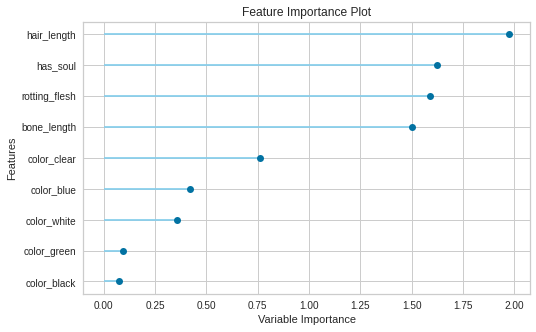

In [ ]:
plot_model(classification_lr,plot='feature')

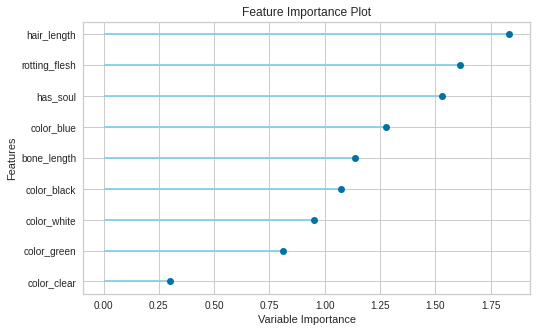

In [ ]:
plot_model(classification_lda, plot='feature')

**Logistic Regression  and LDA** performed quite good when feature selection is set and **hair_lenght is the most significant feature**

### **6.5. With Feature Selection and Normalization and PCA**

In [ ]:
setup(data=ghoul_train, target='type', feature_selection=True, normalize=True, pca=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,3877
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     Component_1  Component_2  ...  Component_6  Component_7
 0      -0.809622    -1.002997  ...    -0.176008    -0.036004
 1      -0.578100    -0.079954  ...     0.691950    -0.667864
 2      -2.420538    -0.650295  ...     0.836588     0.733971
 3      -3.014730     1.359161  ...     0.643194     0.693478
 4       0.007097     2.863506  ...     0.598587    -0.753393
 ..           ...          ...  ...          ...          ...
 366    -1.289223    -0.543627  ...     0.331779     0.012970
 367     0.198527     0.136884  ...     0.795942    -0.699765
 368    -0.347226     0.105211  ...    -0.330153    -0.020152
 369     1.342865     0.993098  ...    -0.361695    -0.016331
 370    -1.570739     2.378827  ...    -0.346672    -0.027544
 
 [371 rows x 7 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      Component_1  Component_2  ...  Component_6  Component_7
 194    -0.072639  

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Logistic Regression,0.784200,0.000000,0.786600,0.794700,0.773000,0.676100
1,Naive Bayes,0.784200,0.000000,0.787000,0.794400,0.774900,0.676400
2,Quadratic Discriminant Analysis,0.768800,0.000000,0.771800,0.781800,0.761500,0.653400
3,Linear Discriminant Analysis,0.768800,0.000000,0.769900,0.773700,0.755800,0.652600
4,Ridge Classifier,0.753200,0.000000,0.755600,0.761900,0.737100,0.629400
5,CatBoost Classifier,0.753200,0.000000,0.756900,0.768800,0.748900,0.629800
6,Extreme Gradient Boosting,0.745200,0.000000,0.749100,0.768100,0.742400,0.617600
7,Gradient Boosting Classifier,0.741500,0.000000,0.744900,0.762800,0.738500,0.612300
8,Extra Trees Classifier,0.734000,0.000000,0.736100,0.748400,0.730600,0.600500
9,Light Gradient Boosting Machine,0.733800,0.000000,0.738000,0.749600,0.727000,0.600200


In [ ]:
classification_lr=create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8462,0.0,0.8519,0.8471,0.8407,0.7694
1,0.7692,0.0,0.7778,0.8282,0.7507,0.6564
2,0.7692,0.0,0.7731,0.7635,0.7612,0.6541
3,0.8077,0.0,0.8148,0.8125,0.8043,0.7118
4,0.7692,0.0,0.7731,0.7858,0.7502,0.6533
5,0.8462,0.0,0.8519,0.8755,0.8323,0.7699
6,0.6538,0.0,0.6667,0.6269,0.6306,0.4823
7,0.7308,0.0,0.7176,0.7133,0.7104,0.5928
8,0.7692,0.0,0.7593,0.8053,0.7669,0.6510
9,0.8800,0.0,0.8796,0.8889,0.8822,0.8197


In [ ]:
tuned_classification_lr=tune_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8077,0.0,0.8148,0.8115,0.7958,0.7124
1,0.7692,0.0,0.7778,0.8282,0.7507,0.6564
2,0.7692,0.0,0.7731,0.7635,0.7612,0.6541
3,0.8077,0.0,0.8148,0.8125,0.8043,0.7118
4,0.7692,0.0,0.7731,0.8071,0.7559,0.6526
5,0.8077,0.0,0.8102,0.8110,0.7957,0.7118
6,0.6923,0.0,0.7037,0.6747,0.6774,0.5398
7,0.6923,0.0,0.6806,0.6731,0.6784,0.5357
8,0.7692,0.0,0.7639,0.8156,0.7744,0.6518
9,0.8800,0.0,0.8796,0.8889,0.8822,0.8197


In [ ]:
evaluate_model(classification_lr)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
classification_nb=create_model('nb')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.6923,0.0,0.7037,0.6857,0.6822,0.5398
1,0.8462,0.0,0.8519,0.8666,0.8445,0.7704
2,0.7692,0.0,0.7778,0.8282,0.7507,0.6564
3,0.7692,0.0,0.7778,0.7639,0.7647,0.6541
4,0.8077,0.0,0.8102,0.8173,0.7967,0.7111
5,0.8077,0.0,0.8102,0.8066,0.8054,0.7118
6,0.6154,0.0,0.6296,0.5868,0.5956,0.4248
7,0.8077,0.0,0.7963,0.8063,0.7924,0.7092
8,0.8462,0.0,0.8333,0.8935,0.8345,0.7668
9,0.8800,0.0,0.8796,0.8889,0.8822,0.8197


In [ ]:
tuned_classification_nb=tune_model('nb')

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7308,0.0,0.7407,0.7206,0.7240,0.5965
1,0.8462,0.0,0.8519,0.8505,0.8408,0.7699
2,0.8462,0.0,0.8472,0.8623,0.8492,0.7684
3,0.7692,0.0,0.7685,0.8174,0.7751,0.6518
4,0.8462,0.0,0.8426,0.8601,0.8445,0.7679
5,0.8462,0.0,0.8472,0.8476,0.8409,0.7694
6,0.6538,0.0,0.6667,0.6269,0.6306,0.4823
7,0.7692,0.0,0.7639,0.7744,0.7671,0.6526
8,0.7308,0.0,0.7269,0.7692,0.7330,0.5956
9,0.8800,0.0,0.8796,0.8889,0.8822,0.8197


Models not performed exceedingly good as compared to earlier scenario

### **6.6. With Feature Selection and create clusters**

In [ ]:
setup(data=ghoul_train, target='type', feature_selection=True, create_clusters=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,1061
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     rotting_flesh  data_cluster_1  ...  color_white  color_blue
 0         0.350839             1.0  ...          0.0         0.0
 1         0.425868             0.0  ...          0.0         0.0
 2         0.354330             0.0  ...          0.0         0.0
 3         0.508723             0.0  ...          0.0         0.0
 4         0.875862             0.0  ...          0.0         0.0
 ..             ...             ...  ...          ...         ...
 366       0.391760             0.0  ...          0.0         1.0
 367       0.564836             0.0  ...          0.0         0.0
 368       0.501147             1.0  ...          0.0         0.0
 369       0.771286             1.0  ...          0.0         0.0
 370       0.768469             0.0  ...          1.0         0.0
 
 [371 rows x 9 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 371, dtype: int64,      rotting_flesh  data_cluster

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Linear Discriminant Analysis,0.730200,0.000000,0.731500,0.740000,0.717200,0.594800
1,Ridge Classifier,0.722500,0.000000,0.724500,0.742700,0.692600,0.583600
2,Extreme Gradient Boosting,0.722500,0.000000,0.725000,0.732300,0.719900,0.583700
3,Logistic Regression,0.714800,0.000000,0.716200,0.729900,0.695300,0.571700
4,CatBoost Classifier,0.707100,0.000000,0.710600,0.725100,0.706400,0.561000
5,Light Gradient Boosting Machine,0.702800,0.000000,0.705600,0.716900,0.701800,0.554600
6,Random Forest Classifier,0.699200,0.000000,0.703700,0.720800,0.699300,0.550000
7,Naive Bayes,0.699100,0.000000,0.700900,0.700100,0.688000,0.548200
8,Gradient Boosting Classifier,0.699100,0.000000,0.702800,0.718800,0.699400,0.549400
9,Ada Boost Classifier,0.695200,0.000000,0.699100,0.713900,0.691700,0.543300


Model results were average wrt to earlier experiments

### **6.7. Without Feature Selection and create clusters**

In [ ]:
setup(data=ghoul_train, target='type', create_clusters=True)

 
Setup Succesfully Completed!


,Description,Value
0,session_id,3277
1,Target Type,Multiclass
2,Label Encoded,"Ghost: 0, Ghoul: 1, Goblin: 2"
3,Original Data,"(371, 6)"
4,Missing Values,False
5,Numeric Features,4
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


(     bone_length  rotting_flesh  ...  data_cluster_4  data_cluster_5
 0       0.354512       0.350839  ...             0.0             0.0
 1       0.575560       0.425868  ...             1.0             0.0
 2       0.467875       0.354330  ...             0.0             0.0
 3       0.776652       0.508723  ...             0.0             0.0
 4       0.566117       0.875862  ...             1.0             0.0
 ..           ...            ...  ...             ...             ...
 366     0.458132       0.391760  ...             0.0             1.0
 367     0.331936       0.564836  ...             1.0             0.0
 368     0.481640       0.501147  ...             0.0             0.0
 369     0.294943       0.771286  ...             0.0             0.0
 370     0.670200       0.768469  ...             0.0             0.0
 
 [371 rows x 10 columns], 0      1
 1      2
 2      1
 3      1
 4      0
       ..
 366    2
 367    0
 368    1
 369    0
 370    1
 Name: type, Length: 37

In [ ]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Linear Discriminant Analysis,0.741500,0.000000,0.744400,0.746900,0.729800,0.612300
1,Logistic Regression,0.725800,0.000000,0.729600,0.734500,0.701400,0.589100
2,Light Gradient Boosting Machine,0.722200,0.000000,0.722700,0.737500,0.721200,0.582500
3,Ridge Classifier,0.718500,0.000000,0.721300,0.720700,0.695100,0.577900
4,CatBoost Classifier,0.718300,0.000000,0.720800,0.733000,0.714800,0.577200
5,Gradient Boosting Classifier,0.710900,0.000000,0.713000,0.719800,0.709200,0.566200
6,Extreme Gradient Boosting,0.706900,0.000000,0.708300,0.712000,0.704400,0.560200
7,Random Forest Classifier,0.702800,0.000000,0.705100,0.717900,0.702500,0.553900
8,Extra Trees Classifier,0.699100,0.000000,0.701400,0.712900,0.696400,0.548400
9,Ada Boost Classifier,0.695200,0.000000,0.699500,0.718700,0.695900,0.543300


Model results were average wrt to earlier experiments

From various experiments using PyCaret, came to know following models could be good and can be tuned to acheive better results

- Logistic Regression
- SVM(Linear Kernel)
- Gradient Boosting Classifier
- Extreme Gradient Boosting Classifier
- Light Gradient Boosting Classifier

Also, Boosting and Voting Classifers can be used to further analyze the performance in ensemble scenarios.

Also, data seems to be in range, but normalization improved the result

hair_length is the most significant feature(though other features are also seems to be important)

In [ ]:
!pip install tpot

     |████████████████████████████████| 92kB 2.4MB/s 
     |████████████████████████████████| 163kB 8.5MB/s 
  Created wheel for stopit: filename=stopit-1.1.2-cp36-none-any.whl size=11956 sha256=24bfdfb0792c9cc752527e25bf81314eb1f05d9d7b5d3ebf5ba89748770b49a9
  Stored in directory: /root/.cache/pip/wheels/3c/85/2b/2580190404636bfc63e8de3dff629c03bb795021e1983a6cc7
Successfully built stopit


## **7. Data Pre-Processing**

### **7.1. Label encoding for categorical columns**

In [9]:
X_train=ghoul_train.drop('type', axis=1)
y_train=ghoul_train.loc[:,'type']

In [10]:
X_train.shape

(371, 5)

In [11]:
y_train.shape

(371,)

In [12]:
le = preprocessing.LabelEncoder()

In [13]:
X_train.head()

,bone_length,rotting_flesh,hair_length,has_soul,color
0,0.354512,0.350839,0.465761,0.781142,clear
1,0.575560,0.425868,0.531401,0.439899,green
2,0.467875,0.354330,0.811616,0.791225,black
3,0.776652,0.508723,0.636766,0.884464,black
4,0.566117,0.875862,0.418594,0.636438,green


In [14]:
X_train['color']=le.fit_transform(X_train['color'])

In [15]:
X_train.head()

,bone_length,rotting_flesh,hair_length,has_soul,color
0,0.354512,0.350839,0.465761,0.781142,3
1,0.575560,0.425868,0.531401,0.439899,4
2,0.467875,0.354330,0.811616,0.791225,0
3,0.776652,0.508723,0.636766,0.884464,0
4,0.566117,0.875862,0.418594,0.636438,4


In [16]:
ghoul_test.head()

,bone_length,rotting_flesh,hair_length,has_soul,color
0,0.471774,0.387937,0.706087,0.698537,black
1,0.427332,0.645024,0.565558,0.451462,white
2,0.549602,0.491931,0.660387,0.449809,black
3,0.638095,0.682867,0.471409,0.356924,white
4,0.361762,0.583997,0.377256,0.276364,black


In [17]:
ghoul_test['color']=le.transform(ghoul_test['color'])

In [18]:
ghoul_test.head()

,bone_length,rotting_flesh,hair_length,has_soul,color
0,0.471774,0.387937,0.706087,0.698537,0
1,0.427332,0.645024,0.565558,0.451462,5
2,0.549602,0.491931,0.660387,0.449809,0
3,0.638095,0.682867,0.471409,0.356924,5
4,0.361762,0.583997,0.377256,0.276364,0


In [19]:
y_train=le.fit_transform(y_train)

In [20]:
y_train.shape

(371,)

### **7.2. Removing outliers**

We can maintain following datasets for experiments :

- Normal data
- Data without outliers (as per IQR result and KNN from PYOD - though PyCaret did not perform well after removing outliers, but can experiment)


**Train Data**

In [21]:
#Normal data
print(X_train.head())
print(pd.DataFrame(y_train).head())
print(ghoul_test.head())

   bone_length  rotting_flesh  hair_length  has_soul  color
0     0.354512       0.350839     0.465761  0.781142      3
1     0.575560       0.425868     0.531401  0.439899      4
2     0.467875       0.354330     0.811616  0.791225      0
3     0.776652       0.508723     0.636766  0.884464      0
4     0.566117       0.875862     0.418594  0.636438      4
   0
0  1
1  2
2  1
3  1
4  0
   bone_length  rotting_flesh  hair_length  has_soul  color
0     0.471774       0.387937     0.706087  0.698537      0
1     0.427332       0.645024     0.565558  0.451462      5
2     0.549602       0.491931     0.660387  0.449809      0
3     0.638095       0.682867     0.471409  0.356924      5
4     0.361762       0.583997     0.377256  0.276364      0


In [22]:
#Data without outliers
print(X_train.shape)
print (y_train.shape)
print("**********************")
X_train_noout1=X_train.drop([52, 166, 174, 194, 266])
y_train_noout1=np.delete(y_train, [52, 166, 174, 194, 266])
print(X_train_noout1.shape)
print(y_train_noout1.shape)
print("**********************")
X_train_noout2=X_train.drop([3, 52, 66, 82, 166, 177, 196, 204, 249, 284, 295, 350])
y_train_noout2=np.delete(y_train, [3, 52, 66, 82, 166, 177, 196, 204, 249, 284, 295, 350])
print(X_train_noout2.shape)
print(y_train_noout2.shape)
print("**********************")
X_train_noout3=X_train.drop([166])
y_train_noout3=np.delete(y_train, [166])
print(X_train_noout3.shape)
print(y_train_noout3.shape)
print("**********************")

(371, 5)
(371,)
**********************
(366, 5)
(366,)
**********************
(359, 5)
(359,)
**********************
(370, 5)
(370,)
**********************


### **7.3. LDA Transformation**

Though our data has only 4 input features, but still can experiment with LDA if any feature is prominent in modelling

In [28]:
def select_n_components(var_ratio, goal_var):
  total_variance=0
  n_comp=0

  for explained_variance in var_ratio:
    total_variance  += explained_variance

    n_comp += 1

    if total_variance>=goal_var:
      break

    return n_comp

In [29]:
def get_lda_comp(X, y):
  lda=LDA(n_components=None)

  X_lda=lda.fit(X, y)

  lda_var_ratios=lda.explained_variance_ratio_

  print(select_n_components(lda_var_ratios, 100))

In [30]:
get_lda_comp(X_train, y_train)

1


In [31]:
get_lda_comp(X_train_noout1, y_train_noout1)

1


In [32]:
get_lda_comp(X_train_noout2, y_train_noout2)

1


In [33]:
get_lda_comp(X_train_noout3, y_train_noout3)

1


So number of compoenents for LDA (further in pipeline) can be considered as 1


## **8. Prepare and process various Machine Learning Models**

From PyCaret we observed that following models provided the satisfactory results,

- Logistic Regression
- Random Forest Classifier
- Decision Tree Classifier
- Ada Boost Classifier
- XGBoost Classifier
- Extreme Gradient Boosting Classifier
- Light Gradient Boosting Classifier
- Cat Boost Classifier

Further, ensembling(Bagging) and Voting Classifier further improved the performance.

So, we can analyze the above models along with few which were not too poorly performed in PyCaret like Ridge Classifier and LDA

In [63]:
MLA_columns = ['MLA Name', 'MLA Parameters','MLA Train Accuracy Mean', 'MLA Test Accuracy Mean', 'MLA Recall', 'MLA Precision', 'MLA F1 Score']
MLA_compare = pd.DataFrame(columns = MLA_columns)

def train_predict_default_ml(X, y, num_comp):
  row_index=0
  best_accuracy=0
  best_recall=0
  best_precision=0
  best_f1=0

  X_tr, X_ts, y_tr, y_ts = train_test_split(X, y, test_size = .20, random_state = 0)
  print(X_tr.shape)
  print(X_ts.shape)
  print(y_tr.shape)
  print(y_ts.shape)

  #Logistic Regression CV
  pipe_lrv_1=Pipeline([('classifer1', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_2=Pipeline([('scaler2', StandardScaler()),
                      ('classifer2', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_3=Pipeline([('scaler3', Normalizer()),
                      ('classifer3', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_4=Pipeline([('scaler4', MinMaxScaler()),
                      ('classifer4', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_5=Pipeline([('scaler5', MinMaxScaler()),
                      ('dim_red5', LDA(n_components=num_comp)),
                      ('classifer5', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_6=Pipeline([('scaler6', Normalizer()),
                      ('dim_red6', LDA(n_components=num_comp)),
                      ('classifer6', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_7=Pipeline([('scaler7', StandardScaler()),
                      ('dim_red7', LDA(n_components=num_comp)),
                      ('classifer7', LogisticRegressionCV(cv=5, random_state=0))])
  pipe_lrv_8=Pipeline([('dim_red8', LDA(n_components=num_comp)),
                      ('classifer8', LogisticRegressionCV(cv=5, random_state=0))])
  
  #Logistic Regression
  pipe_lr_1=Pipeline([('classifer9', LogisticRegression(random_state=0))])
  pipe_lr_2=Pipeline([('scaler10', StandardScaler()),
                      ('classifer10', LogisticRegression(random_state=0))])
  pipe_lr_3=Pipeline([('scaler11', Normalizer()),
                      ('classifer11', LogisticRegression(random_state=0))])
  pipe_lr_4=Pipeline([('scaler12', MinMaxScaler()),
                      ('classifer12', LogisticRegression(random_state=0))])
  pipe_lr_5=Pipeline([('scaler13', MinMaxScaler()),
                      ('dim_red13', LDA(n_components=num_comp)),
                      ('classifer13', LogisticRegression(random_state=0))])
  pipe_lr_6=Pipeline([('scaler14', Normalizer()),
                      ('dim_red14', LDA(n_components=num_comp)),
                      ('classifer14', LogisticRegression(random_state=0))])
  pipe_lr_7=Pipeline([('scaler15', StandardScaler()),
                      ('dim_red15', LDA(n_components=num_comp)),
                      ('classifer15', LogisticRegression(random_state=0))])
  pipe_lr_8=Pipeline([('dim_red16', LDA(n_components=num_comp)),
                      ('classifer16', LogisticRegression(random_state=0))])
  
  #Decision Tree
  pipe_dt_1=Pipeline([('classifer17', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_2=Pipeline([('scaler18', StandardScaler()),
                      ('classifer18', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_3=Pipeline([('scaler19', Normalizer()),
                      ('classifer19', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_4=Pipeline([('scaler20', MinMaxScaler()),
                      ('classifer20', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_5=Pipeline([('scaler21', MinMaxScaler()),
                      ('dim_red21', LDA(n_components=num_comp)),
                      ('classifer21', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_6=Pipeline([('scaler22', Normalizer()),
                      ('dim_red22', LDA(n_components=num_comp)),
                      ('classifer22', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_7=Pipeline([('scaler23', StandardScaler()),
                      ('dim_red23', LDA(n_components=num_comp)),
                      ('classifer23', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  pipe_dt_8=Pipeline([('dim_red24', LDA(n_components=num_comp)),
                      ('classifer24', DecisionTreeClassifier(random_state=0, criterion='entropy'))])
  
  #Random Forest
  pipe_rf_1=Pipeline([('classifer25', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_2=Pipeline([('scaler26', StandardScaler()),
                      ('classifer26', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_3=Pipeline([('scaler27', Normalizer()),
                      ('classifer27', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_4=Pipeline([('scaler28', MinMaxScaler()),
                      ('classifer28', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_5=Pipeline([('scaler29', MinMaxScaler()),
                      ('dim_red29', LDA(n_components=num_comp)),
                      ('classifer29', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_6=Pipeline([('scaler30', Normalizer()),
                      ('dim_red30', LDA(n_components=num_comp)),
                      ('classifer30', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_7=Pipeline([('scaler31', StandardScaler()),
                      ('dim_red31', LDA(n_components=num_comp)),
                      ('classifer31', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipe_rf_8=Pipeline([('dim_red32', LDA(n_components=num_comp)),
                      ('classifer32', RandomForestClassifier(random_state=0, criterion='entropy'))])
  pipelines=[pipe_lrv_1,pipe_lrv_2,pipe_lrv_3,pipe_lrv_4,pipe_lrv_5,pipe_lrv_6,pipe_lrv_7,pipe_lrv_8,
             pipe_lr_1,pipe_lr_2,pipe_lr_3,pipe_lr_4,pipe_lr_5,pipe_lr_6,pipe_lr_7,pipe_lr_8,
             pipe_dt_1,pipe_dt_2,pipe_dt_3,pipe_dt_4,pipe_dt_5,pipe_dt_6,pipe_dt_7,pipe_dt_8,
             pipe_rf_1,pipe_rf_2,pipe_rf_3,pipe_rf_4,pipe_rf_5,pipe_rf_6,pipe_rf_7,pipe_rf_8]

  for pipe in pipelines:
    pipe.fit(X_tr, y_tr)
  
  for i,model in enumerate(pipelines):
    MLA_compare.loc[row_index, 'MLA Parameters']=str(model.get_params())
    MLA_compare.loc[row_index, 'MLA Train Accuracy Mean']=model.score(X_tr,y_tr)
    MLA_compare.loc[row_index, 'MLA Test Accuracy Mean']=model.score(X_ts,y_ts)
    y_pred = model.predict(X_ts)
    MLA_compare.loc[row_index, 'MLA Recall']=metrics.recall_score(y_ts, y_pred, average='weighted')
    MLA_compare.loc[row_index, 'MLA Precision']=metrics.precision_score(y_ts, y_pred,average='weighted')
    MLA_compare.loc[row_index, 'MLA F1 Score']=metrics.f1_score(y_ts, y_pred, average='weighted')

    row_index=row_index+1

    if (model.score(X_ts,y_ts)>best_accuracy):
      best_accuracy=model.score(X_ts,y_ts,)
      best_accpipeline=model

    if (metrics.recall_score(y_ts, y_pred, average='weighted')>best_recall):
      best_recall=metrics.recall_score(y_ts, y_pred, average='weighted')
      bestrecpipeline=model

    if (metrics.precision_score(y_ts, y_pred, average='weighted')>best_precision):
      best_precision=metrics.precision_score(y_ts, y_pred, average='weighted')
      bestprcpipeline=model

    if (metrics.f1_score(y_ts, y_pred, average='weighted')>best_f1):
      best_f1=metrics.f1_score(y_ts, y_pred, average='weighted')
      bestf1pipeline=model

    MLA_compare.sort_values(by = ['MLA Test Accuracy Mean'], ascending = False, inplace = True)
    MLA_compare.reset_index(drop=True, inplace=True)
    MLA_compare['Difference']= (MLA_compare['MLA Test Accuracy Mean']-MLA_compare['MLA Train Accuracy Mean'])*100

  print("\nBest Model for accuracy :\n", best_accpipeline)
  print("\n\n\nBest Model for recall :\n", bestrecpipeline)
  print("\n\n\nBest Model for precision :\n", bestprcpipeline)
  print("\n\n\nBest Model for f1score :\n", bestf1pipeline)

  return MLA_compare

In [64]:
MLA_compare_1=train_predict_default_ml(X_train, y_train, 1)
MLA_compare_1

(296, 5)
(75, 5)
(296,)
(75,)

Best Model for accuracy :
 Pipeline(memory=None,
         steps=[('classifer1',
                 LogisticRegressionCV(Cs=10, class_weight=None, cv=5,
                                      dual=False, fit_intercept=True,
                                      intercept_scaling=1.0, l1_ratios=None,
                                      max_iter=100, multi_class='auto',
                                      n_jobs=None, penalty='l2', random_state=0,
                                      refit=True, scoring=None, solver='lbfgs',
                                      tol=0.0001, verbose=0))],
         verbose=False)



Best Model for recall :
 Pipeline(memory=None,
         steps=[('classifer1',
                 LogisticRegressionCV(Cs=10, class_weight=None, cv=5,
                                      dual=False, fit_intercept=True,
                                      intercept_scaling=1.0, l1_ratios=None,
                                      max_iter=100, m

,MLA Name,MLA Parameters,MLA Train Accuracy Mean,MLA Test Accuracy Mean,MLA Recall,MLA Precision,MLA F1 Score,Difference
0,NaN,"{'memory': None, 'steps': [('classifer1', Logi...",0.739865,0.88,0.88,0.880062,0.879298,14.0135
1,NaN,"{'memory': None, 'steps': [('scaler2', Standar...",0.75,0.866667,0.866667,0.867266,0.865311,11.6667
2,NaN,"{'memory': None, 'steps': [('scaler12', MinMax...",0.739865,0.853333,0.853333,0.855018,0.851193,11.3468
3,NaN,"{'memory': None, 'steps': [('scaler10', Standa...",0.739865,0.84,0.84,0.845204,0.841771,10.0135
4,NaN,"{'memory': None, 'steps': [('classifer9', Logi...",0.743243,0.813333,0.813333,0.815556,0.8064,7.00901
5,NaN,"{'memory': None, 'steps': [('scaler4', MinMaxS...",0.746622,0.8,0.8,0.809087,0.792598,5.33784
6,NaN,"{'memory': None, 'steps': [('scaler28', MinMax...",1,0.786667,0.786667,0.797186,0.789302,-21.3333
7,NaN,"{'memory': None, 'steps': [('classifer25', Ran...",1,0.773333,0.773333,0.78678,0.777383,-22.6667
8,NaN,"{'memory': None, 'steps': [('scaler26', Standa...",1,0.773333,0.773333,0.78678,0.777383,-22.6667
9,NaN,"{'memory': None, 'steps': [('scaler18', Standa...",1,0.76,0.76,0.778758,0.763411,-24
